In [1]:
import numpy as np
import pandas as pd
import scanpy as sc
import scrublet as scr
import os
import warnings
import functools
import seaborn as sns
import scipy.stats
import anndata
import multiprocessing

warnings.filterwarnings('ignore')
os.chdir(os.path.expanduser('/home/jovyan/Lee_KJ_Kidney_10x_sep19/scanpy'))

/home/jovyan/my-conda-envs/mypython3/lib/python3.7/site-packages/dask/config.py:161: YAMLLoadWarning: calling yaml.load() without Loader=... is deprecated, as the default Loader is unsafe. Please read https://msg.pyyaml.org/load for full details.
  data = yaml.load(f.read()) or {}


In [2]:
# some set up
sample = ['Adh52', 'Csb1', 'Csb2', 'DKO1', 'DKO2', 'WT1', 'WT2']
group = ['Adh5', 'Csb', 'Csb', 'DKO', 'DKO', 'WT', 'WT']

adata_list = []
for i in range(0, len(sample)):
    inputfolder='../Sept_raw_files/soupx/'+sample[i]+'/'
    # import data
    adata = sc.read_10x_mtx(inputfolder, cache = True)
    adata.obs['sample'] = sample[i]
    adata.obs['group'] = group[i]
    # rename cells to sample id + barcode, cleaving the trailing -1
    adata.obs_names = [str(sample[i])+'_'+str(j).split('-')[0] for j in adata.obs_names]
    adata_list.append(adata)
adata = adata_list[0].concatenate(adata_list[1:], index_unique=None)
# free up memory
del adata_list
adata

Trying to set attribute `.obs` of view, making a copy.
Trying to set attribute `.obs` of view, making a copy.
Trying to set attribute `.obs` of view, making a copy.
Trying to set attribute `.obs` of view, making a copy.
Trying to set attribute `.obs` of view, making a copy.
Trying to set attribute `.obs` of view, making a copy.
Trying to set attribute `.obs` of view, making a copy.


AnnData object with n_obs × n_vars = 138283 × 31053 
    obs: 'batch', 'group', 'sample'
    var: 'gene_ids', 'feature_types'

In [3]:
def bh(pvalues):
    '''
    Computes the Benjamini-Hochberg FDR correction.
    
    Input:
        * pvals - vector of p-values to correct
    '''
    n = int(pvalues.shape[0])
    new_pvalues = np.empty(n)
    values = [ (pvalue, i) for i, pvalue in enumerate(pvalues) ]
    values.sort()
    values.reverse()
    new_values = []
    for i, vals in enumerate(values):
        rank = n - i
        pvalue, index = vals
        new_values.append((n/rank) * pvalue)
    for i in range(0, int(n)-1):
        if new_values[i] < new_values[i+1]:
            new_values[i+1] = new_values[i]
    for i, vals in enumerate(values):
        pvalue, index = vals
        new_pvalues[index] = new_values[i]
    return new_pvalues

# run Krystoff's doublet caller
scorenames = ['scrublet_score','scrublet_cluster_score','bh_pval']

dir = 'scrublet-scores'
if not os.path.exists(dir):
    os.makedirs(dir)

In [4]:
# loop over the subfolders of the main folder
for i in range(0, len(sample)):
    inputfolder='../Sept_raw_files/soupx/'+sample[i]+'/'
    # import data
    adata_sample = sc.read_10x_mtx(inputfolder, cache = True)
    # rename cells to sample id + barcode, cleaving the trailing -1
    adata_sample.obs_names = [str(sample[i])+'_'+str(j).split('-')[0] for j in adata_sample.obs_names]
    # run Scrublet
    scrub = scr.Scrublet(adata_sample.X)
    doublet_scores, predicted_doublets = scrub.scrub_doublets(verbose=False)
    adata_sample.obs['scrublet_score'] = doublet_scores
    # overcluster prep. run turbo basic scanpy pipeline
    sc.pp.filter_genes(adata_sample, min_cells=3)
    sc.pp.normalize_per_cell(adata_sample, counts_per_cell_after=1e4)
    sc.pp.log1p(adata_sample)
    sc.pp.highly_variable_genes(adata_sample, min_mean=0.0125, max_mean=3, min_disp=0.5)
    adata_sample = adata_sample[:, adata_sample.var['highly_variable']]
    sc.pp.scale(adata_sample, max_value=10)
    sc.tl.pca(adata_sample, svd_solver='arpack')
    sc.pp.neighbors(adata_sample)
    # overclustering proper - do basic clustering first, then cluster each cluster
    sc.tl.leiden(adata_sample)
    for clus in np.unique(adata_sample.obs['leiden']):
        sc.tl.leiden(adata_sample, restrict_to=('leiden',[clus]))
    # compute the cluster scores - the median of Scrublet scores per overclustered cluster
    for clus in np.unique(adata_sample.obs['leiden']):
        adata_sample.obs.loc[adata_sample.obs['leiden']==clus, 'scrublet_cluster_score'] = \
            np.median(adata_sample.obs.loc[adata_sample.obs['leiden']==clus, 'scrublet_score'])
    # now compute doublet p-values. figure out the median and mad (from above-median values) for the distribution
    med = np.median(adata_sample.obs['scrublet_cluster_score'])
    mask = adata_sample.obs['scrublet_cluster_score']>med
    mad = np.median(adata_sample.obs['scrublet_cluster_score'][mask]-med)
    # do a one-sided test with Krystoff's implementation
    pvals = 1-scipy.stats.norm.cdf(adata_sample.obs['scrublet_cluster_score'], loc=med, scale=1.4826*mad)
    adata_sample.obs['bh_pval'] = bh(pvals)
    # create results data frame for single sample and copy stuff over from the adata object
    scrublet_sample = pd.DataFrame(0, index=adata_sample.obs_names, columns=scorenames)
    for meta in scorenames:
        scrublet_sample[meta] = adata_sample.obs[meta]
    # write out complete sample scores
    scrublet_sample.to_csv('scrublet-scores/'+sample[i]+'.csv')

Trying to set attribute `.obs` of view, making a copy.
Trying to set attribute `.obs` of view, making a copy.
Trying to set attribute `.obs` of view, making a copy.
Trying to set attribute `.obs` of view, making a copy.
Trying to set attribute `.obs` of view, making a copy.
Trying to set attribute `.obs` of view, making a copy.
Trying to set attribute `.obs` of view, making a copy.


In [5]:
scrdf = []
for i in range(0, len(sample)):
    scrdf.append(pd.read_csv('scrublet-scores/'+sample[i]+'.csv', header=0, index_col=0))
scrdf = pd.concat(scrdf)
for meta in scorenames:
    adata.obs[meta] = scrdf[meta]

In [6]:
# threshold the p-values to get doublet calls.
adata.obs['is_doublet'] = adata.obs['bh_pval'] < 0.1

In [7]:
# clear the unneeded objects
del adata_sample

In [8]:
# now, actually remove doublets and rerun everything
adata = adata[adata.obs['is_doublet'] != True]
adata

View of AnnData object with n_obs × n_vars = 135423 × 31053 
    obs: 'batch', 'group', 'sample', 'scrublet_score', 'scrublet_cluster_score', 'bh_pval', 'is_doublet'
    var: 'gene_ids', 'feature_types'

normalizing counts per cell
    finished (0:00:09)


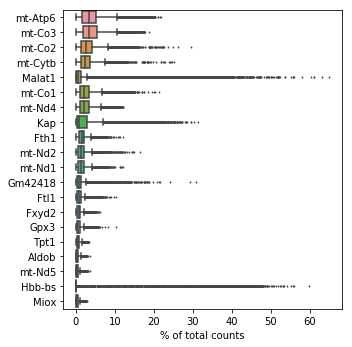

In [9]:
# continue with the standard analysis first
sc.settings.verbosity = 3
# plot higest expr genes
sc.pl.highest_expr_genes(adata, n_top = 20)

In [10]:
# filter cells based on standard cut offs
sc.pp.filter_cells(adata, min_genes = 200)
sc.pp.filter_genes(adata, min_cells = 3)

filtered out 9 cells that have less than 200 genes expressed


Trying to set attribute `.obs` of view, making a copy.


filtered out 9391 genes that are detected in less than 3 cells


In [11]:
# get mitochondria QC stats
mito_genes = adata.var_names.str.startswith('mt-')
adata.obs['percent_mito'] = np.sum(adata[:, mito_genes].X, axis = 1) / np.sum(adata.X, axis = 1)
adata.obs['n_counts'] = adata.X.sum(axis = 1)

... storing 'group' as categorical
... storing 'sample' as categorical
... storing 'feature_types' as categorical


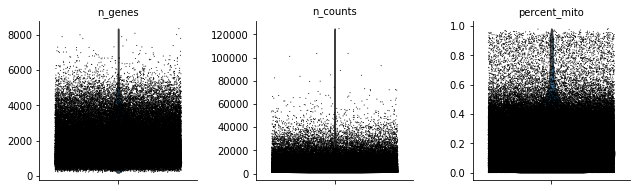

In [12]:
# violin plot of the computed quality measures.
sc.pl.violin(adata, ['n_genes', 'n_counts', 'percent_mito'], jitter = 0.4, multi_panel = True)

In [13]:
# final filtering
adata = adata[adata.obs['n_genes'] < 2500, :]
adata = adata[adata.obs['percent_mito'] < 0.5, :] # relatively high because of epithelial cells
adata

View of AnnData object with n_obs × n_vars = 106531 × 21662 
    obs: 'batch', 'group', 'sample', 'scrublet_score', 'scrublet_cluster_score', 'bh_pval', 'is_doublet', 'n_genes', 'percent_mito', 'n_counts'
    var: 'gene_ids', 'feature_types', 'n_cells'

In [14]:
# median genes
adata.obs.n_genes.median()

1146.0

In [15]:
# median nUMI
adata.obs.n_counts.median()

2894.579

In [16]:
# normalize matrix X to 10000 reads per cell
# sc.pp.normalize_total(adata)
sc.pp.normalize_per_cell(adata, counts_per_cell_after=1e4)
# Logarithmize the data
sc.pp.log1p(adata)
# Set the .raw attribute of AnnData object to the logarithmized raw gene expression for later use in differential testing and visualizations of gene expression. 
adata.raw = adata

normalizing by total count per cell


Trying to set attribute `.obs` of view, making a copy.


    finished (0:00:02): normalized adata.X and added    'n_counts', counts per cell before normalization (adata.obs)


extracting highly variable genes
    finished (0:00:03)
--> added
    'highly_variable', boolean vector (adata.var)
    'means', float vector (adata.var)
    'dispersions', float vector (adata.var)
    'dispersions_norm', float vector (adata.var)


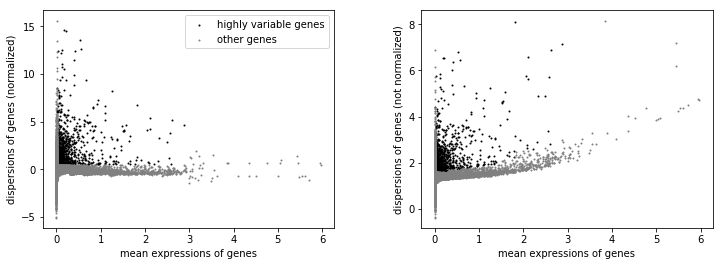

In [17]:
# Identify highly-variable genes.
sc.pp.highly_variable_genes(adata, min_mean = 0.0125, max_mean = 3, min_disp = 0.5)
# plot highly_variable_genes
sc.pl.highly_variable_genes(adata)

In [18]:
# store cell cycle analysis for later
s_genes = ['Mcm4', 'Exo1', 'Slbp', 'Gmnn', 'Cdc45', 'Msh2', 'Mcm6', 'Rrm2', 'Pold3', 'Blm', 'Ubr7', 'Mcm5', 'Clspn', 'Hells', 'Nasp', 'Rpa2', 'Rad51ap1', 'Tyms', 'Rrm1', 'Rfc2', 'Prim1', 'Brip1', 'Usp1', 'Ung', 'Pola1', 'Mcm2', 'Fen1', 'Tipin', 'Pcna', 'Cdca7', 'Uhrf1', 'Casp8ap2', 'Cdc6', 'Dscc1', 'Wdr76', 'E2f8', 'Dtl', 'Ccne2', 'Atad2', 'Gins2', 'Chaf1b', 'Pcna-ps2']
g2m_genes = ['Nuf2', 'Psrc1', 'Ncapd2', 'Ccnb2', 'Smc4', 'Lbr', 'Tacc3', 'Cenpa', 'Kif23', 'Cdca2', 'Anp32e', 'G2e3', 'Cdca3', 'Anln', 'Cenpe', 'Gas2l3', 'Tubb4b', 'Cenpf', 'Dlgap5', 'Hjurp', 'Cks1brt', 'Gtse1', 'Bub1', 'Birc5', 'Ube2c', 'Rangap1', 'Hmmr', 'Ect2', 'Tpx2', 'Ckap5', 'Cbx5', 'Nek2', 'Ttk', 'Cdca8', 'Nusap1', 'Ctcf', 'Cdc20', 'Cks2', 'Mki67', 'Tmpo', 'Ckap2l', 'Aurkb', 'Kif2c', 'Cdk1', 'Kif20b', 'Top2a', 'Aurka', 'Ckap2', 'Hmgb2', 'Cdc25c', 'Ndc80', 'Kif11']
sc.tl.score_genes_cell_cycle(adata, s_genes=s_genes, g2m_genes=g2m_genes)

calculating cell cycle phase
computing score 'S_score'
    finished: added
    'S_score', score of gene set (adata.obs) (0:00:02)
computing score 'G2M_score'
    finished: added
    'G2M_score', score of gene set (adata.obs) (0:00:02)
-->     'phase', cell cycle phase (adata.obs)


In [19]:
# Actually do the filtering.
adata = adata[:, adata.var['highly_variable']]

In [20]:
# Regress out effects of total counts per cell, percentage of mitochondrial genes, and cell cycle state. Scale the data to unit variance.
sc.pp.regress_out(adata, ['n_counts', 'percent_mito', 'S_score', 'G2M_score'], n_jobs = multiprocessing.cpu_count()-1)
# Scale each gene to unit variance. Clip values exceeding standard deviation 10.
sc.pp.scale(adata, max_value = 10)

regressing out ['n_counts', 'percent_mito', 'S_score', 'G2M_score']
    sparse input is densified and may lead to high memory use


Trying to set attribute `.obs` of view, making a copy.
... storing 'phase' as categorical


    finished (0:04:30)


computing PCA with n_comps = 100
    on highly variable genes
    finished (0:00:22)


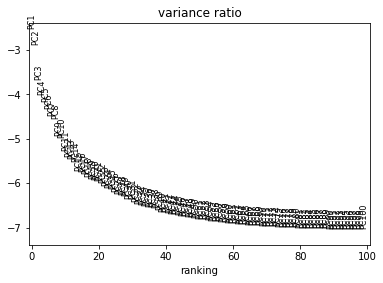

In [21]:
# Principal component analysis
sc.tl.pca(adata, svd_solver = 'arpack', n_comps = 100)
sc.pl.pca_variance_ratio(adata, log = True, n_pcs = 100)

In [22]:
# check object
adata

AnnData object with n_obs × n_vars = 106531 × 1366 
    obs: 'batch', 'group', 'sample', 'scrublet_score', 'scrublet_cluster_score', 'bh_pval', 'is_doublet', 'n_genes', 'percent_mito', 'n_counts', 'S_score', 'G2M_score', 'phase'
    var: 'gene_ids', 'feature_types', 'n_cells', 'highly_variable', 'means', 'dispersions', 'dispersions_norm'
    uns: 'log1p', 'pca'
    obsm: 'X_pca'
    varm: 'PCs'

In [30]:
# Computing the neighborhood graph. Seurat uses k = 20 as default
sc.pp.neighbors(adata, n_neighbors = 20, n_pcs = 80)
# run UMAP
sc.tl.umap(adata, n_components = 2, min_dist = 0.3)

computing neighbors
    using 'X_pca' with n_pcs = 80
    finished: added to `.uns['neighbors']`
    'distances', distances for each pair of neighbors
    'connectivities', weighted adjacency matrix (0:02:03)
computing UMAP
    finished: added
    'X_umap', UMAP coordinates (adata.obsm) (0:02:34)


running Leiden clustering
    finished: found 19 clusters and added
    'leiden', the cluster labels (adata.obs, categorical) (0:02:14)


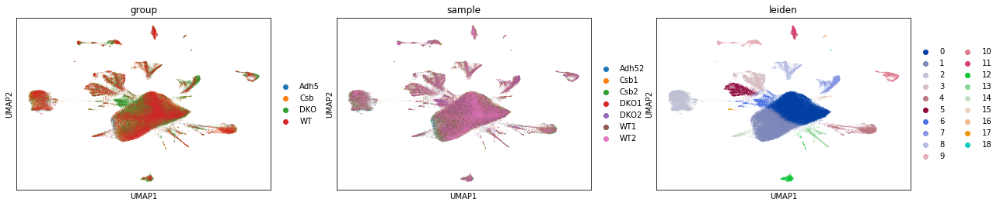

In [42]:
# find clusters
sc.tl.leiden(adata, resolution = 0.5)
# plotting groups and clusters
sc.pl.umap(adata, color = ['group', 'sample', 'leiden'])

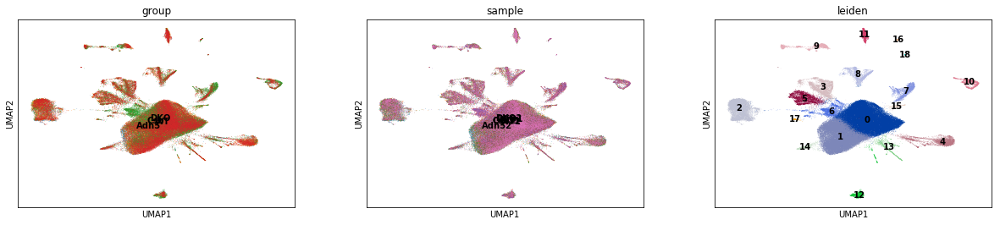

In [43]:
sc.pl.umap(adata, color = ['group', 'sample', 'leiden'], legend_loc = 'on data')

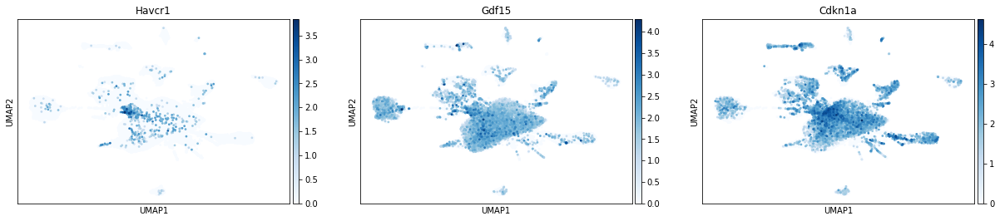

In [40]:
# plot some genes
sc.pl.umap(adata, color = ['Havcr1', 'Gdf15', 'Cdkn1a'], color_map = 'Blues', size = 30)

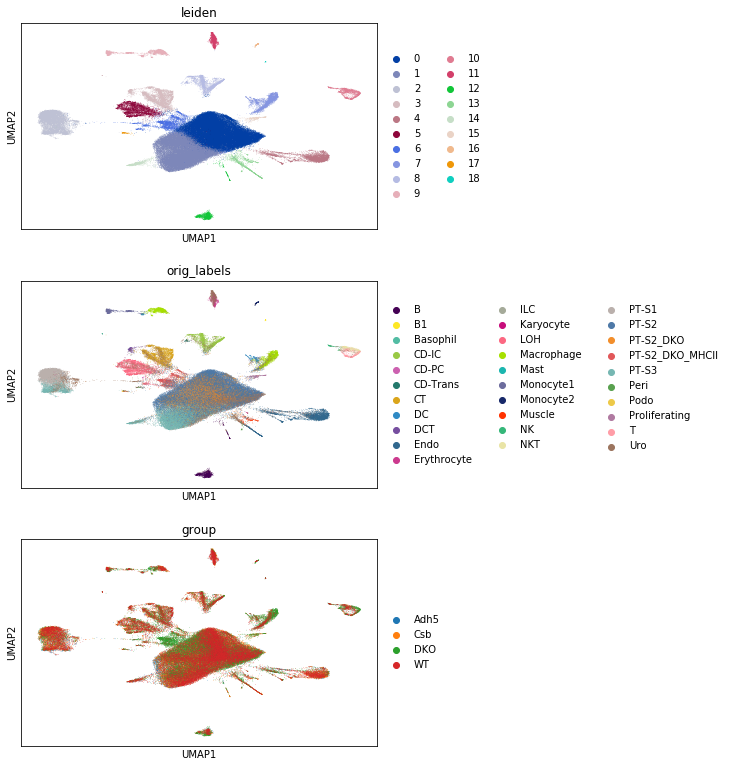

In [45]:
# transfer the original labels and see where they are now
adatao = sc.read_h5ad('./out/post_scrublet.results_new.h5ad')
adatao
# reformat the cell barcode to match the new object
adatao.obs['new_name'] = [str(s) + '_' + str(j).split('-')[0] for s, j in zip(adatao.obs['sample'], adatao.obs.index)]
adatao.obs_names = adatao.obs['new_name']
adatao.obs['orig_labels'] = adatao.obs['final_labels']
# transfer the meta
adata.obs = pd.merge(adata.obs, adatao.obs['orig_labels'], how = 'left', left_index=True, right_index=True)
adata.uns['orig_labels_colors'] = adatao.uns['final_labels_colors']
sc.pl.umap(adata, color = ['leiden', 'orig_labels', 'group'],ncols = 1)

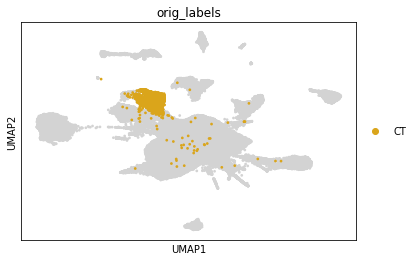

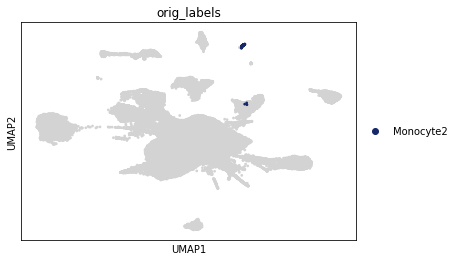

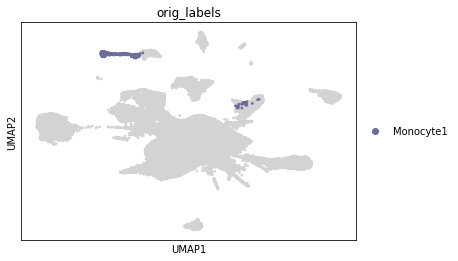

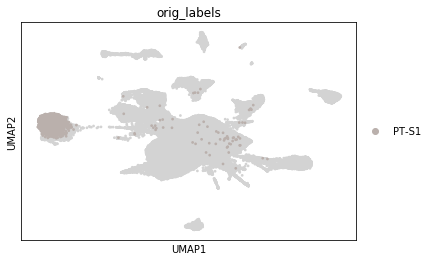

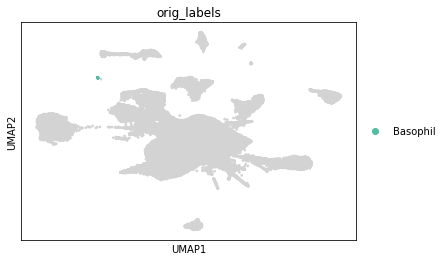

...

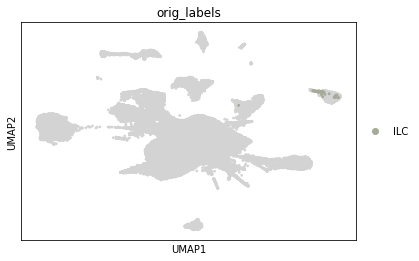

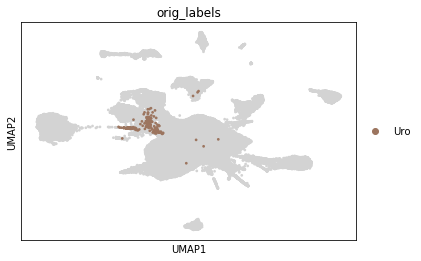

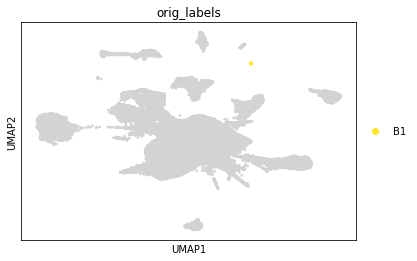

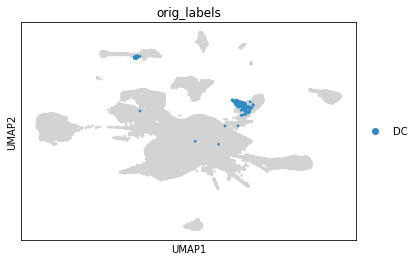

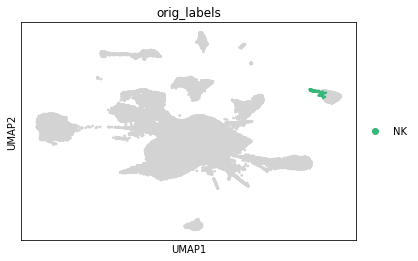

In [4]:
for i in['CT', 'Monocyte2', 'Monocyte1', 'PT-S1', 'Basophil', 'Podo', 'Macrophage', 'CD-IC', 'T', 'PT-S2_DKO_MHCII', 'NKT', 'PT-S2', 'CD-PC', 'CD-Trans', 'Karyocyte', 'DCT', 'LOH', 'Muscle', 'Endo', 'PT-S3', 'Erythrocyte', 'Proliferating', 'PT-S2_DKO', 'B', 'Peri', 'ILC', 'Uro', 'B1', 'DC', 'NK']:
    sc.pl.umap(adata, color = ['orig_labels'], groups = [str(i)], size = 30)

In [ ]:
# drop these labels
adata.obs = adata.obs.drop(['orig_labels', 'orig_labels_x', 'orig_labels_y'], axis=1)

In [46]:
# save this file
results_file = 'out/Lee_Sept_new.h5ad'
adata.write(results_file, compression = 'gzip')

In [1]:
import numpy as np
import pandas as pd
import scanpy as sc
import scrublet as scr
import os
import warnings
import functools
import seaborn as sns
import scipy.stats
import anndata
import multiprocessing

warnings.filterwarnings('ignore')
os.chdir(os.path.expanduser('/home/jovyan/Lee_KJ_Kidney_10x_sep19/scanpy'))

results_file = 'out/Lee_Sept_new.h5ad'

adata = sc.read_h5ad(results_file)
adata

/home/jovyan/my-conda-envs/mypython3/lib/python3.7/site-packages/dask/config.py:161: YAMLLoadWarning: calling yaml.load() without Loader=... is deprecated, as the default Loader is unsafe. Please read https://msg.pyyaml.org/load for full details.
  data = yaml.load(f.read()) or {}


AnnData object with n_obs × n_vars = 106531 × 1366 
    obs: 'batch', 'group', 'sample', 'scrublet_score', 'scrublet_cluster_score', 'bh_pval', 'is_doublet', 'n_genes', 'percent_mito', 'n_counts', 'S_score', 'G2M_score', 'phase', 'leiden', 'Park_Endo_score', 'Park_Peri_score', 'Park_Podo_score', 'Park_PCT-S1_score', 'Park_PT-S2_score', 'Park_PST-S3_score', 'Park_DLH_score', 'Park_LOH_score', 'Park_DCT_score', 'Park_CD-IC-A_score', 'Park_CD-IC-B_score', 'Park_CD-Trans_score', 'Park_CD-PC_score', 'Park_Fibro_score', 'Park_Macro_score', 'Park_Neutro_score', 'Park_Bcell_score', 'Park_Tcell_score', 'Park_NKcell_score', 'Park_Novel1_score', 'Park_Novel2_score', 'celltype'
    var: 'gene_ids', 'feature_types', 'n_cells', 'highly_variable', 'means', 'dispersions', 'dispersions_norm'
    uns: 'celltype_colors', 'dendrogram_leiden', 'group_colors', 'leiden', 'leiden_colors', 'neighbors', 'orig_labels_colors', 'pca', 'rank_genes_groups', 'sample_colors', 'umap'
    obsm: 'X_pca', 'X_umap'
    var

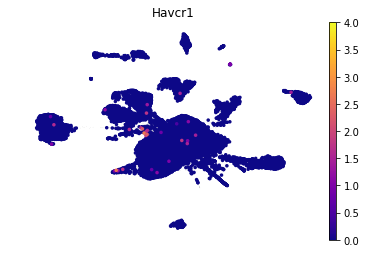

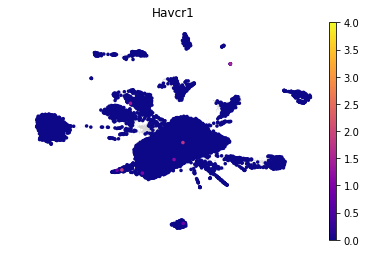

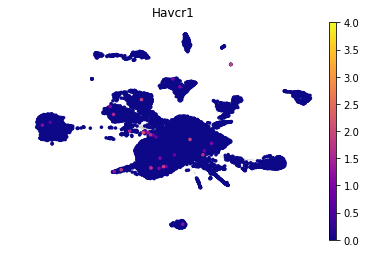

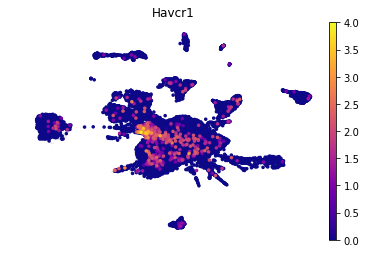

In [28]:
outpath = 'figures/umap'
if not os.path.exists(outpath):
        os.makedirs(outpath)
for x in ['WT', 'Adh5', 'Csb', 'DKO']:
    ax = sc.pl.umap(adata,  show=False)
    sc.pl.umap(adata[adata.obs["group"] == x], color = ['Havcr1'], size=50, color_map = 'plasma', frameon=False, ax=ax, vmax = 4, save='/Lee_'+str(x)+'_Havcr1_umap.pdf')

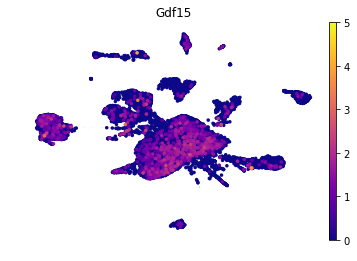

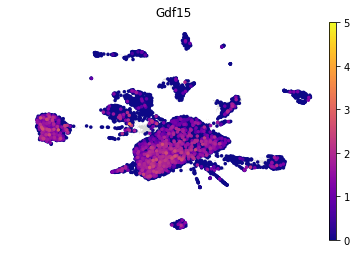

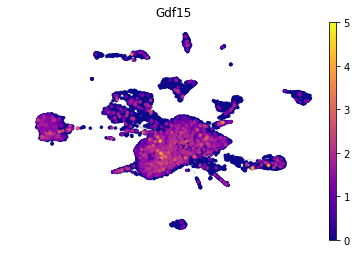

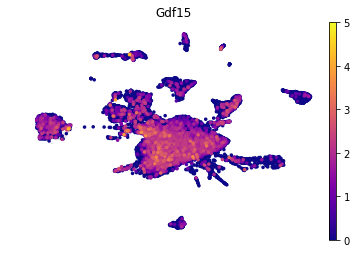

In [29]:
for x in ['WT', 'Adh5', 'Csb', 'DKO']:
    ax = sc.pl.umap(adata,  show=False)
    sc.pl.umap(adata[adata.obs["group"] == x], color = ['Gdf15'], size=50, color_map = 'plasma', frameon=False, ax=ax, vmax = 5, save='/Lee_'+str(x)+'_Gdf15_umap.pdf')

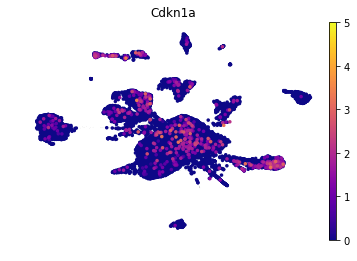

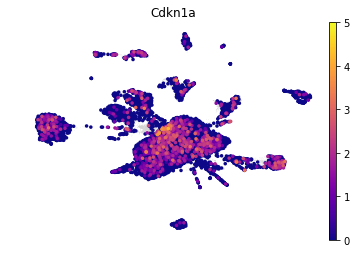

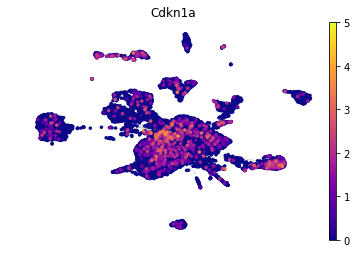

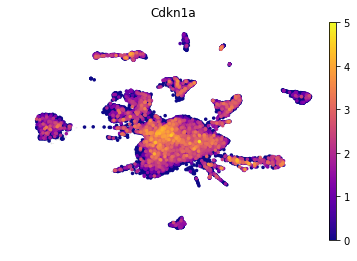

In [30]:
for x in ['WT', 'Adh5', 'Csb', 'DKO']:
    ax = sc.pl.umap(adata,  show=False)
    sc.pl.umap(adata[adata.obs["group"] == x], color = ['Cdkn1a'], size=50, color_map = 'plasma', frameon=False, ax=ax, vmax = 5, save='/Lee_'+str(x)+'_Cdkn1a_umap.pdf')

categories: 0, 1, 2, etc.
var_group_labels: MHCII, Stress, Damage, etc.


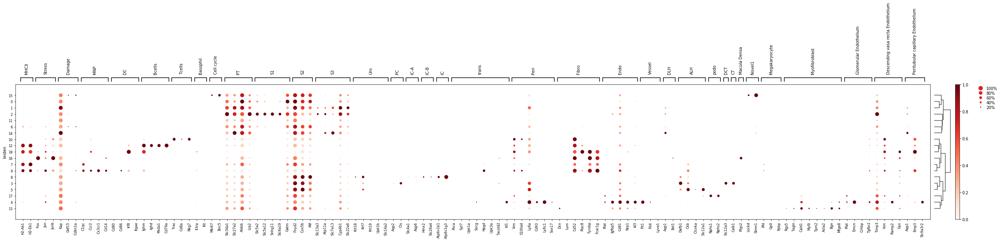

In [2]:
marker_genes_dict = {'MHCII':['H2-Ab1','H2-Eb1'],
    'Stress':['Fos', 'Jun', 'Junb'],
    'Damage':['Kap', 'Gdf15','Cdkn1a'],
    'MNP':['C1qc', 'Ccr2', 'Cx3cr1', 'Cd14'],
    'DC' : ['Cd80', 'Cd86', 'Irf8', 'Itgae'],
    'Bcells':['Ighm', 'Ighd', 'Ms4a1', 'Cd79a'],
    'Tcells':['Trac', 'Cd8a', 'Nkg7'],
    'Basophil' : ['Il3ra', 'Kit'],
    'Cell cycle':['Mki67', 'Birc5'],
    'PT':['Slc34a1', 'Slc27a2', 'Aldob', 'Lrp2'],
    'S1':['Slc5a2', 'Slc5a12', 'Snhg11', 'Slc6a19','Gatm'],
    'S2':['Fxyd2', 'Cox5b','Mif'],
    'S3':['Slc13a3', 'Atp11a', 'Slc7a13', 'Cyp4b1', 'Slc22a6'],
    'Uro':['Krt18','Krt7', 'Krt19', 'Upk1b', 'Slc14a2'],
    'PC':['Aqp2','Clu'],
    'IC-A':['Slc4a1', 'Aqp6'],
    'IC-B':['Hmx2', 'Slc26a4'],
    'IC':['Atp6v1b1', 'Atp6v1g3'],
    'trans':['Psca', 'Syt7', 'Upk1a', 'Sncg', 'Hpgd', 'Upk3a', 'Tacstd2', 'Id1'],
    'Peri':['Vim', 'S100a4', 'Ly6a','Cd93', 'Ly6c1', 'Sox17'],
    'Fibro':['Dcn', 'Lum', 'Cd52', 'Plac8', 'Tyrobp', 'Fcer1g'],
    'Endo':['Plat', 'Igfbp5', 'Cd81', 'Nrp1','Id3'],
    'Vessel':['Flt1','Flt4', 'Lyve1'],
    'DLH':['Aqp1', 'Bst1'],
    'ALH':['Defb1', 'Ckb', 'Clcnka', 'Slc12a1'],
    'podo':['Nphs1', 'Nphs2'],
    'DCT':['Slc12a3'],
    'CT':['Calb1'],
    'Macula Densa':['Ptgs2'],
    'Novel1':['Lockd', 'Stmn1'],
    'Megakaryocyte': ['Pf4', 'Gp9', 'Ppbp'],
    'Myofibroblast': ['Rgs5', 'Tagln', 'Cald1', 'Myl9', 'Tpm2', 'Acta2', 'Bgn', 'Mfge8'],
    'Glomerular Endothelium': ['Plat', 'Emcn', 'Crhbp', 'Tgfbr2'],
    'Descending vasa recta Endothelium': ['Timp3', 'Vim', 'Ramp2', 'Gsn'],
    'Peritubular capillary Endothelium': ['Aqp1', 'Emp3', 'Slc9a3r2']}
ax = sc.pl.dotplot(adata, marker_genes_dict, groupby='leiden', dendrogram=True, standard_scale='var')

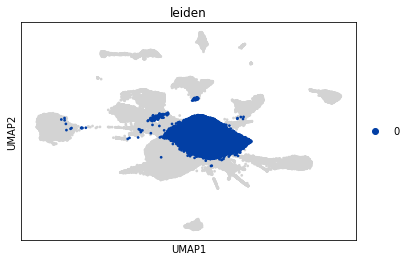

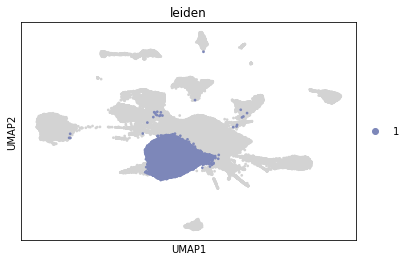

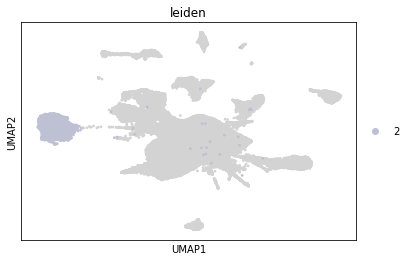

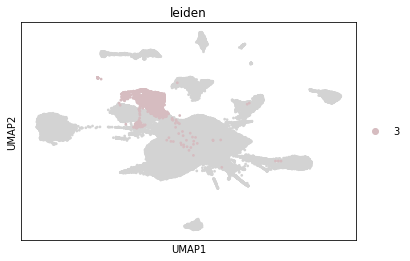

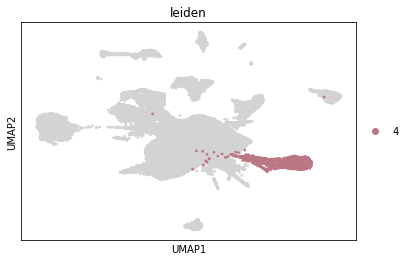

...

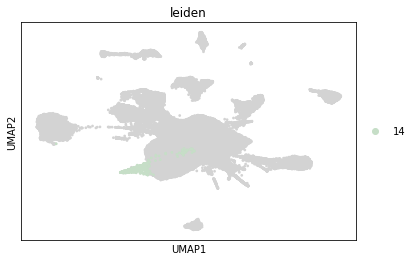

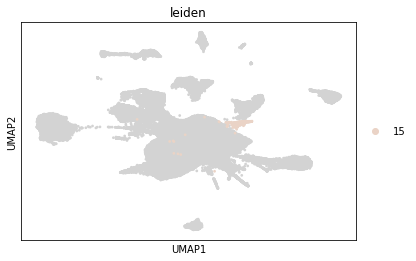

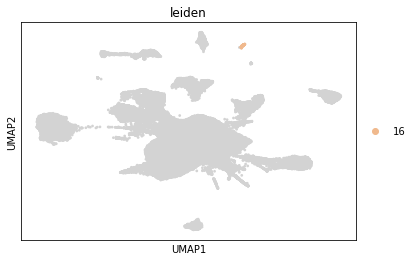

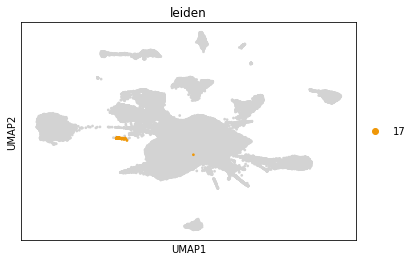

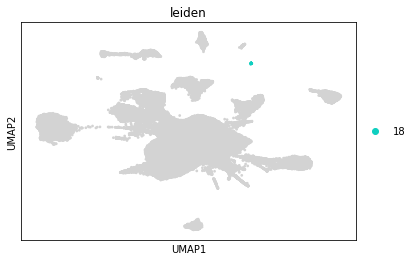

In [3]:
clusters = list(set(adata.obs['leiden']))
clusters = sorted(clusters, key=lambda x: int(x))
for i in clusters:
    sc.pl.umap(adata, color = ['leiden'], groups = [str(i)], size = 30)

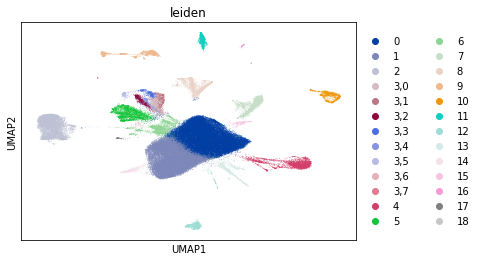

In [7]:
sc.tl.leiden(adata, resolution = 0.5, restrict_to = ('leiden', ['3']))
sc.pl.umap(adata, color = 'leiden')

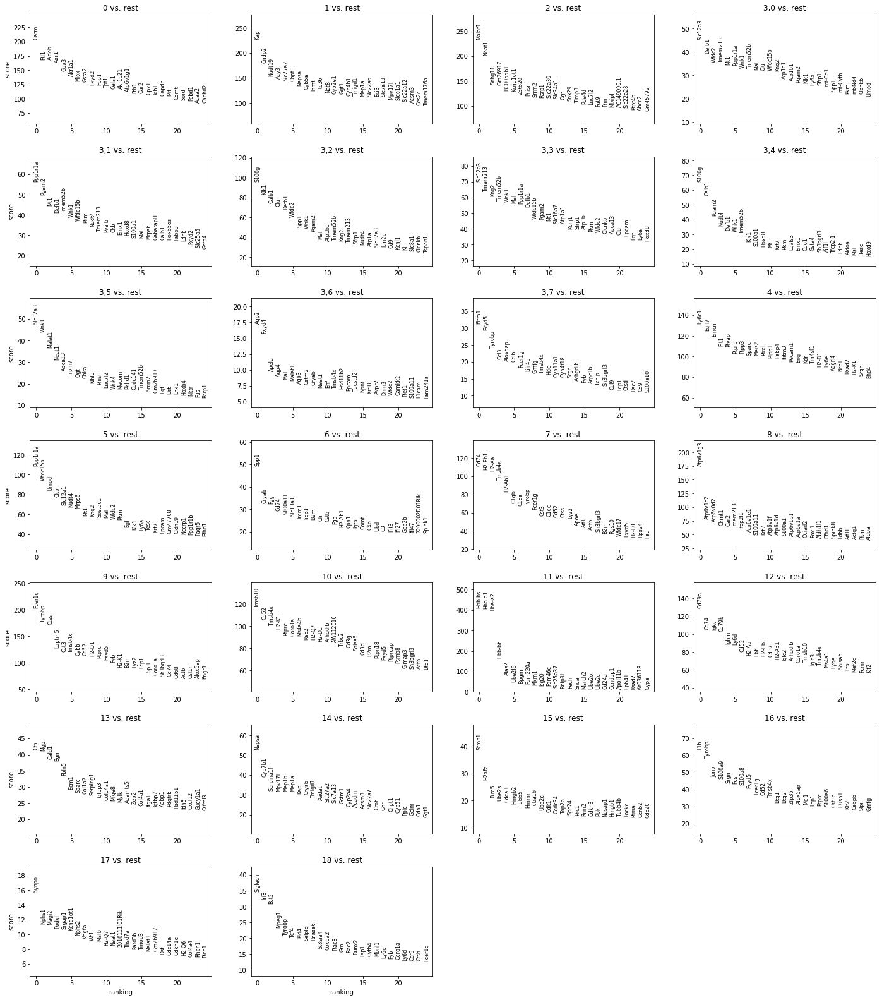

In [8]:
sc.tl.rank_genes_groups(adata, groupby = 'leiden')
sc.pl.rank_genes_groups(adata, n_genes=25, sharey=False)

categories: 0, 1, 2, etc.
var_group_labels: MHCII, Stress, Damage, etc.


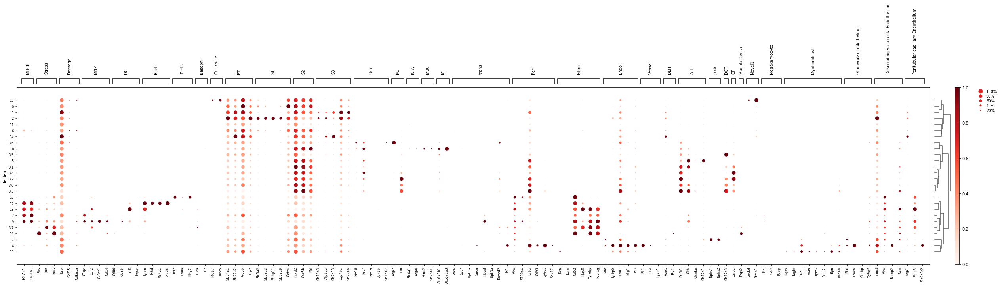

In [9]:
marker_genes_dict = {'MHCII':['H2-Ab1','H2-Eb1'],
    'Stress':['Fos', 'Jun', 'Junb'],
    'Damage':['Kap', 'Gdf15','Cdkn1a'],
    'MNP':['C1qc', 'Ccr2', 'Cx3cr1', 'Cd14'],
    'DC' : ['Cd80', 'Cd86', 'Irf8', 'Itgae'],
    'Bcells':['Ighm', 'Ighd', 'Ms4a1', 'Cd79a'],
    'Tcells':['Trac', 'Cd8a', 'Nkg7'],
    'Basophil' : ['Il3ra', 'Kit'],
    'Cell cycle':['Mki67', 'Birc5'],
    'PT':['Slc34a1', 'Slc27a2', 'Aldob', 'Lrp2'],
    'S1':['Slc5a2', 'Slc5a12', 'Snhg11', 'Slc6a19','Gatm'],
    'S2':['Fxyd2', 'Cox5b','Mif'],
    'S3':['Slc13a3', 'Atp11a', 'Slc7a13', 'Cyp4b1', 'Slc22a6'],
    'Uro':['Krt18','Krt7', 'Krt19', 'Upk1b', 'Slc14a2'],
    'PC':['Aqp2','Clu'],
    'IC-A':['Slc4a1', 'Aqp6'],
    'IC-B':['Hmx2', 'Slc26a4'],
    'IC':['Atp6v1b1', 'Atp6v1g3'],
    'trans':['Psca', 'Syt7', 'Upk1a', 'Sncg', 'Hpgd', 'Upk3a', 'Tacstd2', 'Id1'],
    'Peri':['Vim', 'S100a4', 'Ly6a','Cd93', 'Ly6c1', 'Sox17'],
    'Fibro':['Dcn', 'Lum', 'Cd52', 'Plac8', 'Tyrobp', 'Fcer1g'],
    'Endo':['Plat', 'Igfbp5', 'Cd81', 'Nrp1','Id3'],
    'Vessel':['Flt1','Flt4', 'Lyve1'],
    'DLH':['Aqp1', 'Bst1'],
    'ALH':['Defb1', 'Ckb', 'Clcnka', 'Slc12a1'],
    'podo':['Nphs1', 'Nphs2'],
    'DCT':['Slc12a3'],
    'CT':['Calb1'],
    'Macula Densa':['Ptgs2'],
    'Novel1':['Lockd', 'Stmn1'],
    'Megakaryocyte': ['Pf4', 'Gp9', 'Ppbp'],
    'Myofibroblast': ['Rgs5', 'Tagln', 'Cald1', 'Myl9', 'Tpm2', 'Acta2', 'Bgn', 'Mfge8'],
    'Glomerular Endothelium': ['Plat', 'Emcn', 'Crhbp', 'Tgfbr2'],
    'Descending vasa recta Endothelium': ['Timp3', 'Vim', 'Ramp2', 'Gsn'],
    'Peritubular capillary Endothelium': ['Aqp1', 'Emp3', 'Slc9a3r2']}
ax = sc.pl.dotplot(adata, marker_genes_dict, groupby='leiden', dendrogram=True, standard_scale='var')

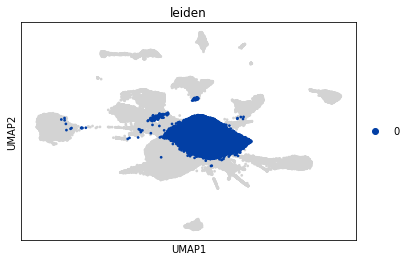

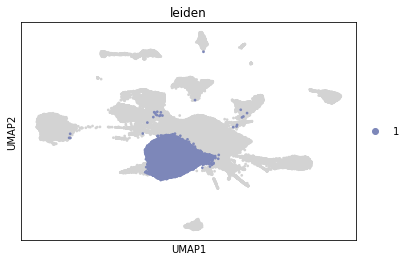

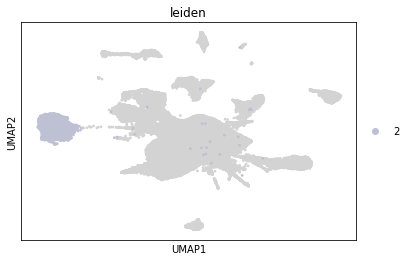

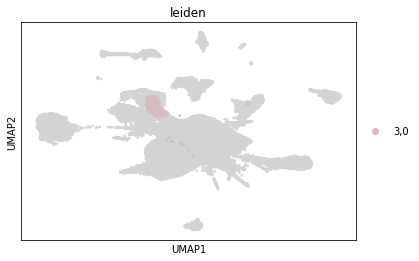

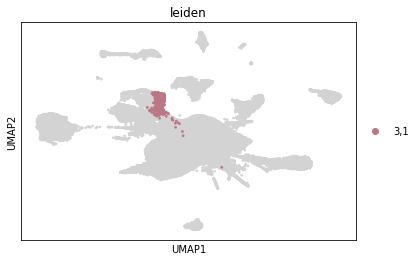

...

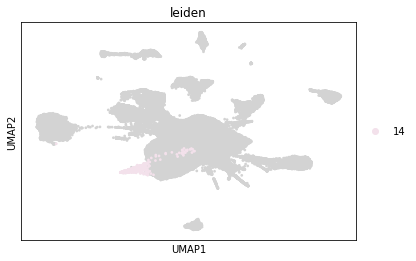

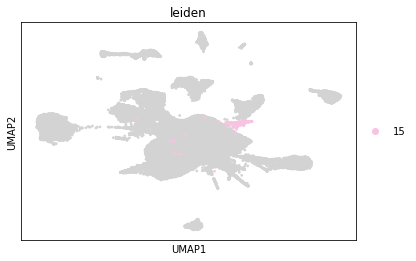

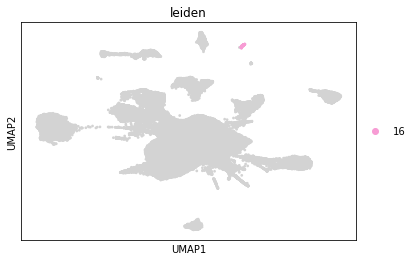

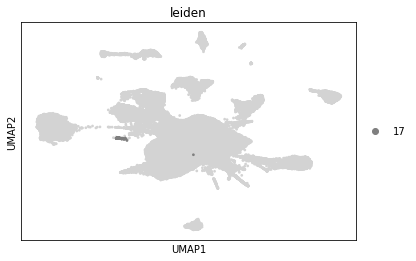

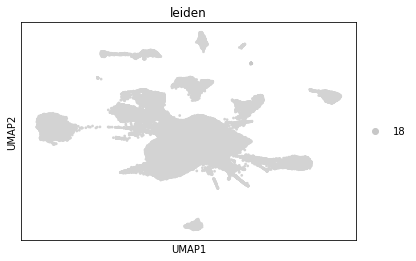

In [11]:
clusters = list(set(adata.obs['leiden']))
clusters = sorted(clusters, key=lambda x: float(x.replace(',', '.')))
for i in clusters:
    sc.pl.umap(adata, color = ['leiden'], groups = [str(i)], size = 30)

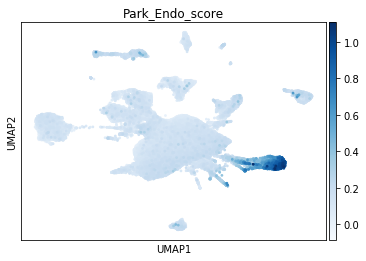

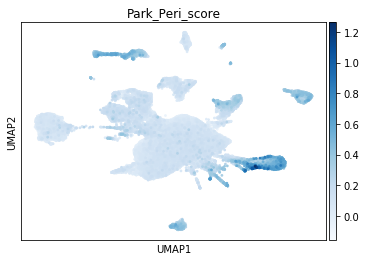

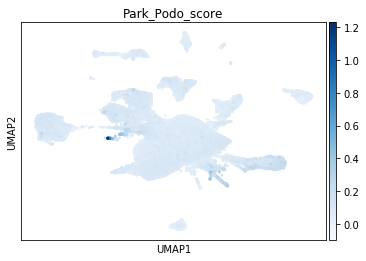

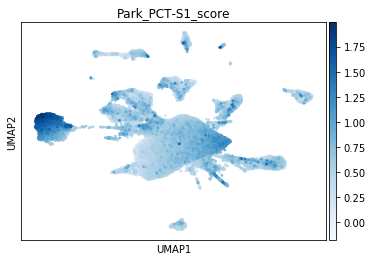

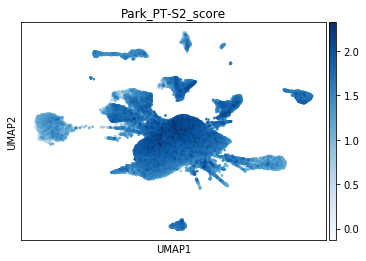

...

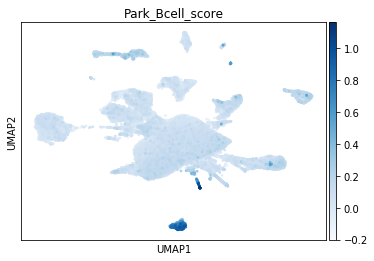

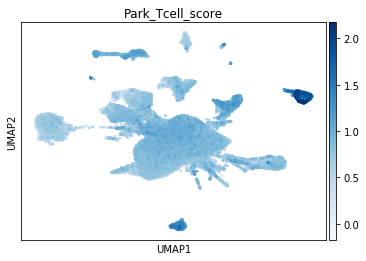

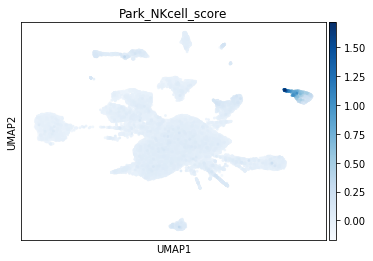

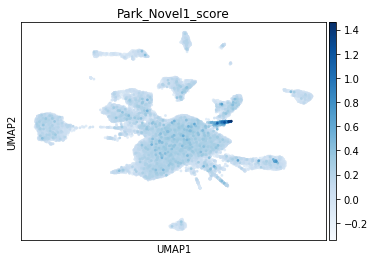

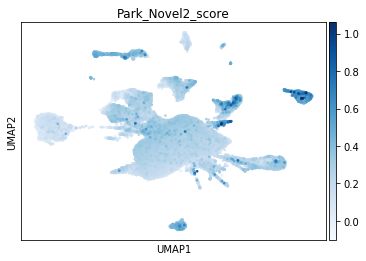

In [12]:
park = pd.read_csv('../dataset/parketalclustermarkers.csv', dtype = 'object')
for gs in list(park.columns):
    sc.tl.score_genes(adata, [x for x in park[gs] if str(x) != 'nan'], score_name = 'Park_'+str(gs)+'_score', use_raw=True)

for gs in list(park.columns):
    sc.pl.umap(adata, color = ['Park_'+str(gs)+'_score'], color_map = 'Blues', size = 30)

... storing 'celltype' as categorical


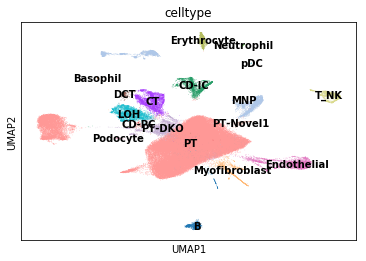

In [25]:
label_dict =  {'0':'PT', '1':'PT', '2':'PT', '3,0':'CT', '3,1':'CT', '3,2':'CT', '3,3':'CT', '3,4':'CT', '3,5':'DCT', '3,6':'CD-PC', '3,7':'Basophil', '4':'Endothelial', '5':'LOH', '6':'PT-DKO', '7':'MNP', '8':'CD-IC', '9':'MNP', '10':'T_NK', '11':'Erythrocyte', '12':'B', '13':'Myofibroblast', '14':'PT', '15':'PT-Novel1', '16':'Neutrophil', '17':'Podocyte', '18':'pDC'}
adata.obs['celltype'] = [label_dict[x] for x in adata.obs['leiden']]
sc.pl.umap(adata, color = ['celltype'], legend_loc = 'on data')

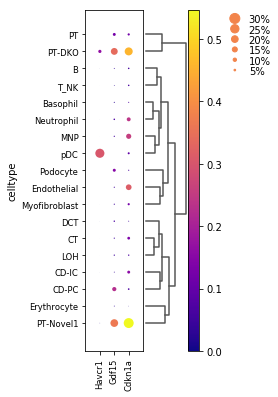

In [26]:
outpath = 'figures/dotplot'
if not os.path.exists(outpath):
        os.makedirs(outpath)
ax = sc.pl.dotplot(adata, ['Havcr1','Gdf15','Cdkn1a'], groupby='celltype', dendrogram=True, use_raw = True, color_map = 'plasma', save = '/Lee_damage_markers.pdf')

In [27]:
# save this result
adata.write(results_file, compression = 'gzip')

In [5]:
import numpy as np
import pandas as pd
import scanpy as sc
import scrublet as scr
import os
import warnings
import functools
import seaborn as sns
import scipy.stats
import anndata
import multiprocessing

warnings.filterwarnings('ignore')
os.chdir(os.path.expanduser('/home/jovyan/Lee_KJ_Kidney_10x_sep19/scanpy'))

results_file = 'out/Lee_Sept_new.h5ad'

adata = sc.read_h5ad(results_file)
adata

AnnData object with n_obs × n_vars = 106531 × 1366 
    obs: 'batch', 'group', 'sample', 'scrublet_score', 'scrublet_cluster_score', 'bh_pval', 'is_doublet', 'n_genes', 'percent_mito', 'n_counts', 'S_score', 'G2M_score', 'phase', 'leiden', 'Park_Endo_score', 'Park_Peri_score', 'Park_Podo_score', 'Park_PCT-S1_score', 'Park_PT-S2_score', 'Park_PST-S3_score', 'Park_DLH_score', 'Park_LOH_score', 'Park_DCT_score', 'Park_CD-IC-A_score', 'Park_CD-IC-B_score', 'Park_CD-Trans_score', 'Park_CD-PC_score', 'Park_Fibro_score', 'Park_Macro_score', 'Park_Neutro_score', 'Park_Bcell_score', 'Park_Tcell_score', 'Park_NKcell_score', 'Park_Novel1_score', 'Park_Novel2_score', 'celltype'
    var: 'gene_ids', 'feature_types', 'n_cells', 'highly_variable', 'means', 'dispersions', 'dispersions_norm'
    uns: 'celltype_colors', 'dendrogram_celltype', 'dendrogram_leiden', 'group_colors', 'leiden', 'leiden_colors', 'neighbors', 'orig_labels_colors', 'pca', 'rank_genes_groups', 'sample_colors', 'umap'
    obsm: 'X

In [28]:
# subset to proximal tubules
pt = adata[adata.obs['celltype'].isin(['PT', 'PT-DKO', 'PT-Novel1'])]
pt = sc.AnnData(pt.raw.X, obs = pt.obs, uns = pt.uns, obsm =pt.obsm, var = pt.raw.var)

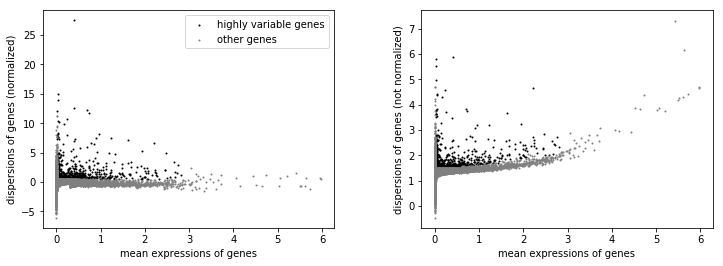

In [29]:
# save a copy to raw
pt.raw = pt
# find variable genes
sc.pp.highly_variable_genes(pt, min_mean = 0.0125, max_mean = 3, min_disp = 0.5)
# plot highly_variable_genes
sc.pl.highly_variable_genes(pt)

In [30]:
# Actually do the filtering.
pt = pt[:, pt.var['highly_variable']]

In [31]:
# Regress out effects of total counts per cell, percentage of mitochondrial genes, and cell cycle state. Scale the data to unit variance.
sc.pp.regress_out(pt, ['n_counts', 'percent_mito', 'S_score', 'G2M_score'], n_jobs = multiprocessing.cpu_count()-1)
# Scale each gene to unit variance. Clip values exceeding standard deviation 10.
sc.pp.scale(pt, max_value = 10)

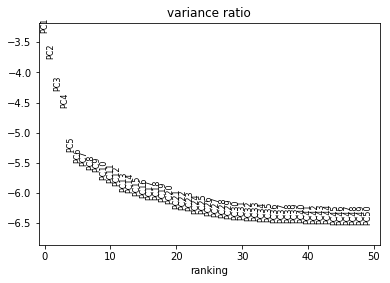

In [32]:
# Principal component analysis
sc.tl.pca(pt, svd_solver = 'arpack', n_comps = 50)
sc.pl.pca_variance_ratio(pt, log = True, n_pcs = 50)

In [33]:
# Computing the neighborhood graph. Seurat uses k = 20 as default
sc.pp.neighbors(pt, n_neighbors = 20, n_pcs = 30)
# run UMAP
sc.tl.umap(pt, n_components = 2, min_dist = 0.3)

In [34]:
# find clusters
sc.tl.leiden(pt, resolution = 0.5, key_added = 'leiden_pt')

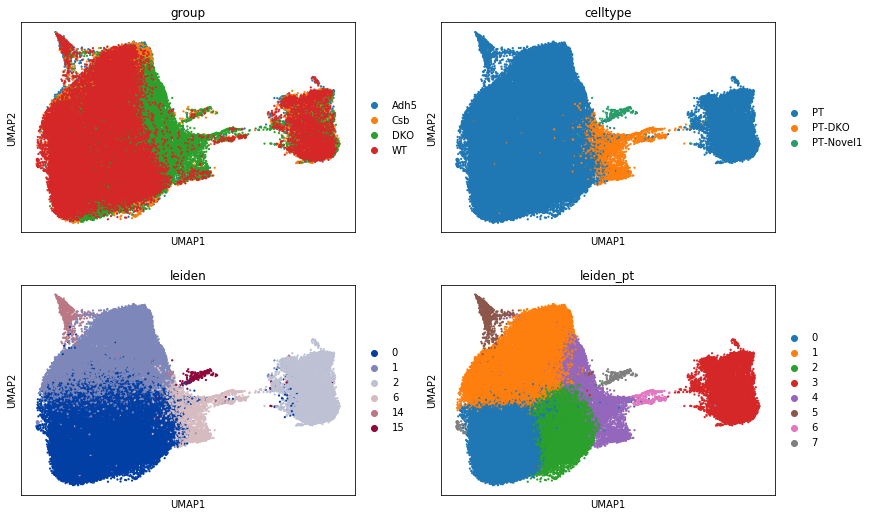

In [35]:
# plotting groups and clusters
sc.pl.umap(pt, color = ['group', 'celltype', 'leiden', 'leiden_pt'], ncols = 2, size = 20)

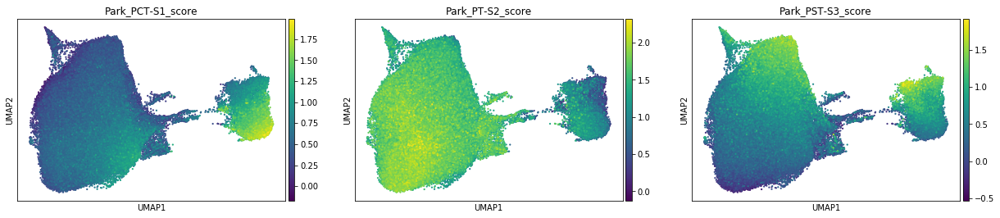

In [36]:
sc.pl.umap(pt, color = ['Park_PCT-S1_score', 'Park_PT-S2_score', 'Park_PST-S3_score'], size = 20)

categories: 0, 1, 2, etc.
var_group_labels: Damage, PT, S1, etc.


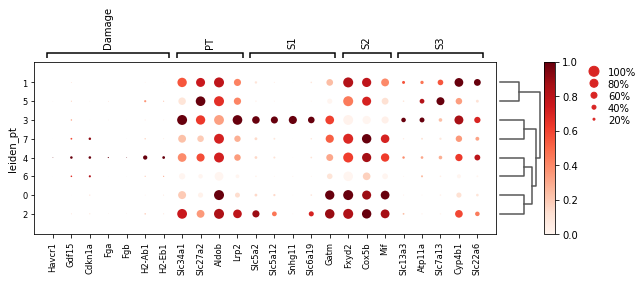

In [37]:
sc.tl.dendrogram(pt, groupby = 'leiden_pt')
marker_genes_dict = {
    'Damage':['Havcr1','Gdf15','Cdkn1a', 'Fga', 'Fgb', 'H2-Ab1','H2-Eb1'],
    'PT':['Slc34a1', 'Slc27a2', 'Aldob', 'Lrp2'],
    'S1':['Slc5a2', 'Slc5a12', 'Snhg11', 'Slc6a19','Gatm'],
    'S2':['Fxyd2', 'Cox5b','Mif'],
    'S3':['Slc13a3', 'Atp11a', 'Slc7a13', 'Cyp4b1', 'Slc22a6']}
ax = sc.pl.dotplot(pt, marker_genes_dict, groupby='leiden_pt', dendrogram=True, standard_scale='var', use_raw = True)

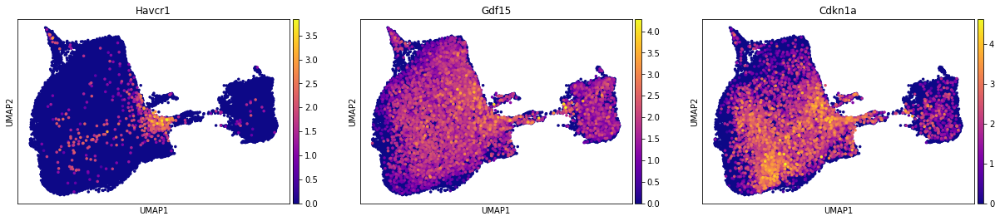

In [38]:
sc.pl.umap(pt, color = ['Havcr1', 'Gdf15', 'Cdkn1a'], size = 50, color_map = 'plasma', use_raw = True)

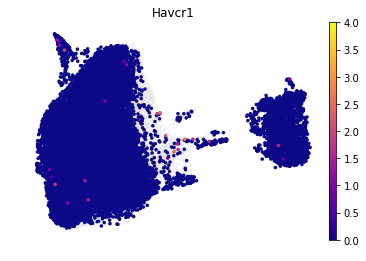

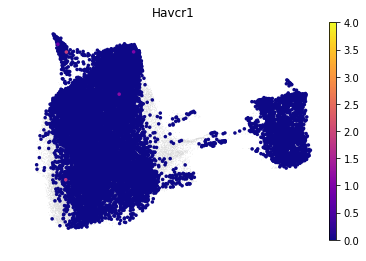

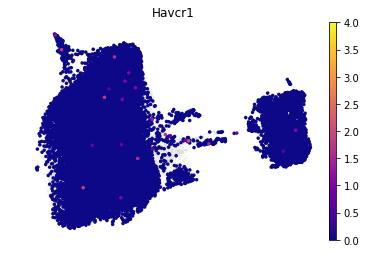

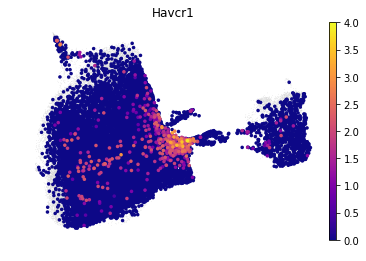

In [39]:
outpath = 'figures/umap'
if not os.path.exists(outpath):
        os.makedirs(outpath)
for x in ['WT', 'Adh5', 'Csb', 'DKO']:
    ax = sc.pl.umap(pt,  show=False)
    sc.pl.umap(pt[pt.obs["group"] == x], color = ['Havcr1'], size=50, color_map = 'plasma', frameon=False, ax=ax, vmax = 4, save='/pt_'+str(x)+'_Havcr1_umap.pdf')

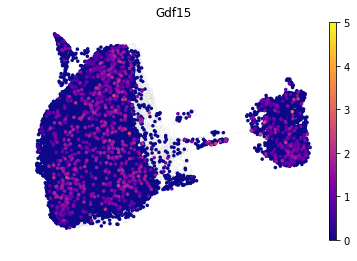

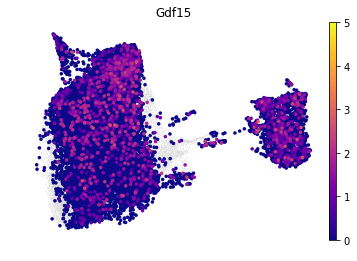

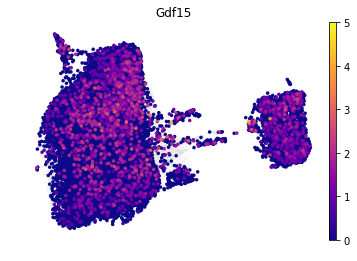

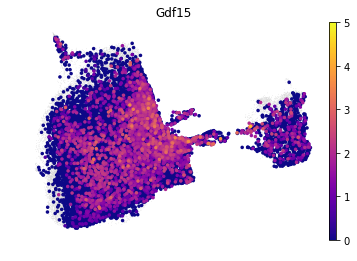

In [40]:
for x in ['WT', 'Adh5', 'Csb', 'DKO']:
    ax = sc.pl.umap(pt,  show=False)
    sc.pl.umap(pt[pt.obs["group"] == x], color = ['Gdf15'], size=50, color_map = 'plasma', frameon=False, ax=ax, vmax = 5, save='/pt_'+str(x)+'_Gdf15_umap.pdf')

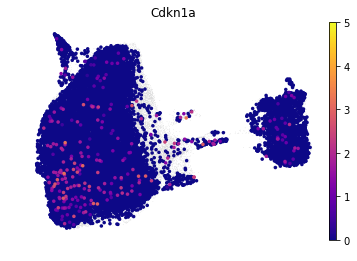

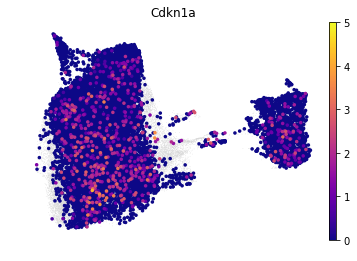

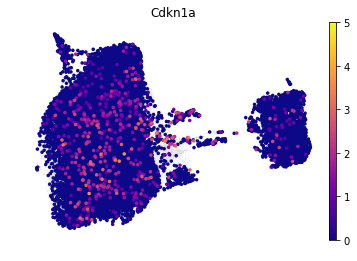

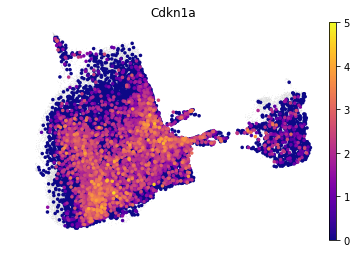

In [41]:
for x in ['WT', 'Adh5', 'Csb', 'DKO']:
    ax = sc.pl.umap(pt,  show=False)
    sc.pl.umap(pt[pt.obs["group"] == x], color = ['Cdkn1a'], size=50, color_map = 'plasma', frameon=False, ax=ax, vmax = 5, save='/pt_'+str(x)+'_Cdkn1a_umap.pdf')

In [42]:
pt_file = 'out/Lee_Sept_new_pt.h5ad'
pt.write(pt_file, compression = 'gzip')

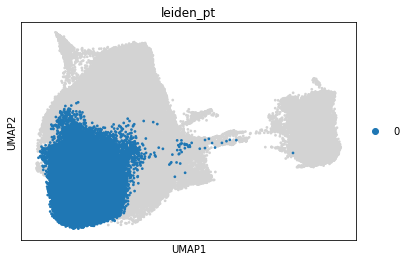

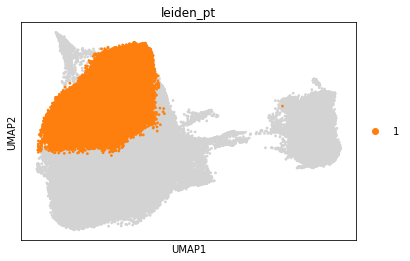

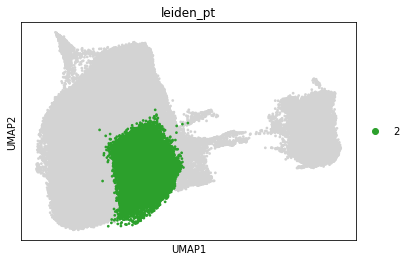

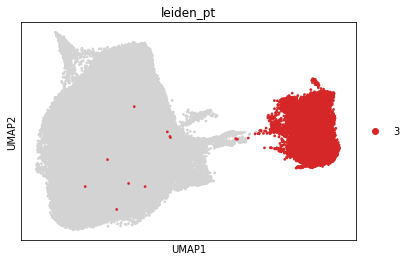

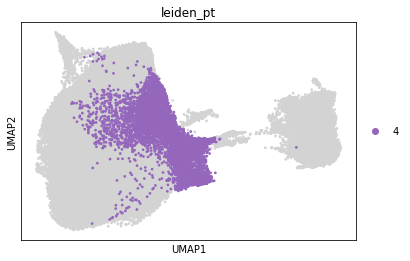

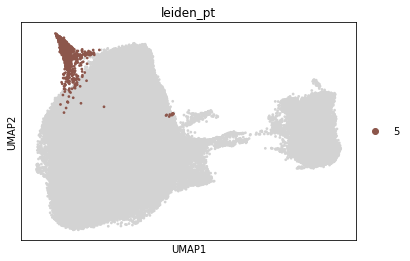

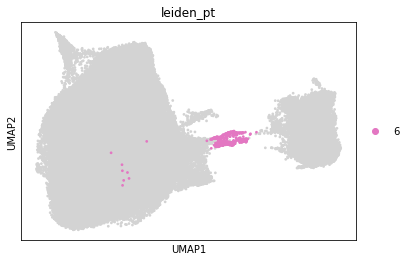

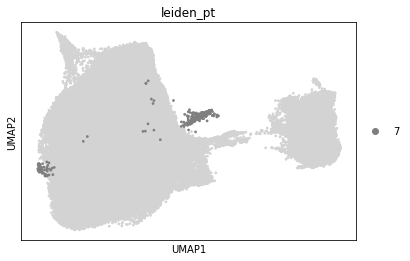

In [43]:
clusters = list(set(pt.obs['leiden_pt']))
clusters = sorted(clusters, key=lambda x: int(x))
for i in clusters:
    sc.pl.umap(pt, color = ['leiden_pt'], groups = [str(i)], size = 30)

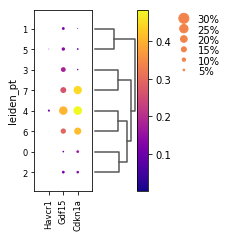

In [44]:
outpath = 'figures/dotplot'
if not os.path.exists(outpath):
        os.makedirs(outpath)
ax = sc.pl.dotplot(pt, ['Havcr1','Gdf15','Cdkn1a'], groupby='leiden_pt', dendrogram=True, use_raw = True, color_map = 'plasma', save = '/pt_damage_markers.pdf')

In [1]:
import numpy as np
import pandas as pd
import scanpy as sc
import scrublet as scr
import os
import warnings
import functools
import seaborn as sns
import scipy.stats
import anndata
import multiprocessing

warnings.filterwarnings('ignore')
os.chdir(os.path.expanduser('/home/jovyan/Lee_KJ_Kidney_10x_sep19/scanpy'))

pt_file = 'out/Lee_Sept_new_pt.h5ad'

pt = sc.read_h5ad(pt_file)

/home/jovyan/my-conda-envs/mypython3/lib/python3.7/site-packages/dask/config.py:161: YAMLLoadWarning: calling yaml.load() without Loader=... is deprecated, as the default Loader is unsafe. Please read https://msg.pyyaml.org/load for full details.
  data = yaml.load(f.read()) or {}


In [2]:
# make new labels for the PTs
label_dict =  {'0':'PT-0', '1':'PT-1', '2':'PT-2', '3':'PT-3', '4':'PT-4-DKO', '5':'PT-5', '6':'PT-6', '7':'PT-7-Novel1'}
pt.obs['pt_celltype'] = [label_dict[x] for x in pt.obs['leiden_pt']]

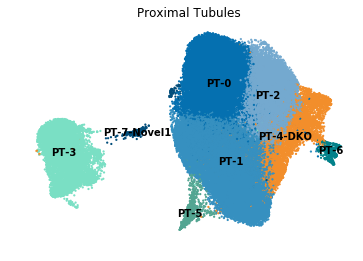

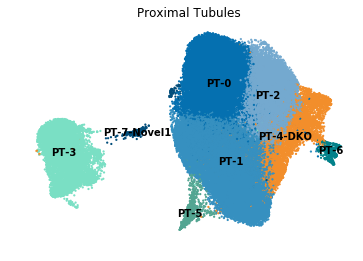

In [8]:
# use paga to reinitialise umap
sc.tl.paga(pt)
sc.pl.paga(pt, plot=False)  # remove `plot=False` if you want to see the coarse-grained graph
sc.tl.umap(pt, init_pos='paga', n_components = 2, min_dist = 0.3)
sc.pl.umap(pt, color = ['pt_celltype'], palette =['#0570b0', '#3690c0', '#74a9cf', '#7ADFC4', '#F28E2b', '#53A592', '#02818a', '#034e7b'], size = 20, frameon = False, title = 'Proximal Tubules', legend_loc = 'on data')
sc.pl.umap(pt, color = ['pt_celltype'], size = 20, legend_loc = 'on data', frameon = False, title = 'Proximal Tubules', save = '/Proximal_tubules_umap.pdf')

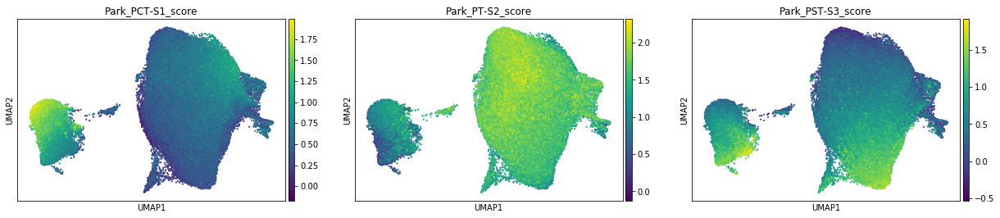

In [10]:
# visualise the enrichment of the Park proximal tubules
sc.pl.umap(pt, color = ['Park_PCT-S1_score', 'Park_PT-S2_score', 'Park_PST-S3_score'], size = 20)

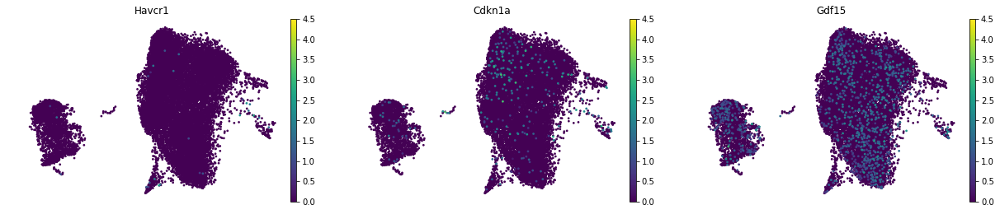

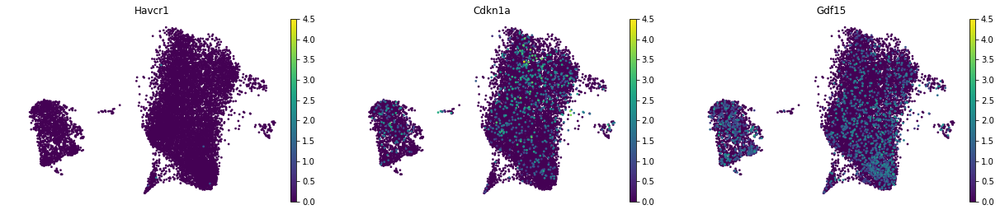

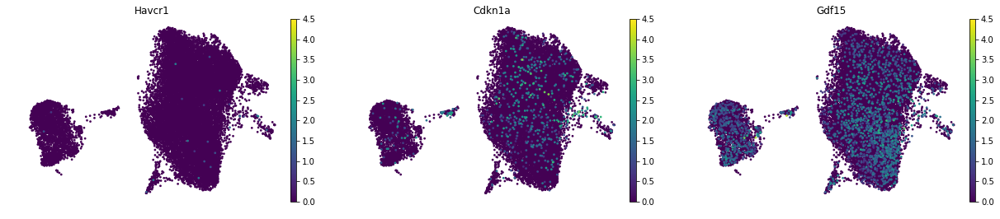

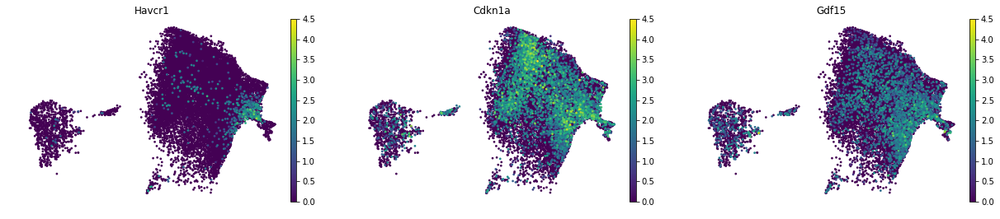

In [4]:
for x in ['WT', 'Adh5', 'Csb', 'DKO']:
    # ax = sc.pl.umap(pt, show=False)
    sc.pl.umap(pt[pt.obs["group"] == x], color = ['Havcr1', 'Cdkn1a', 'Gdf15'], color_map = 'viridis', size=20, frameon=False, vmax = 4.5, save='/Lee_'+str(x)+'_damage_markers_umap.pdf')

In [5]:
# save the new embedding
pt.write(pt_file, compression = 'gzip')

In [3]:
import numpy as np
import pandas as pd
import scanpy as sc
import scrublet as scr
import os
import warnings
import functools
import seaborn as sns
import scipy.stats
import anndata
import multiprocessing

warnings.filterwarnings('ignore')
os.chdir(os.path.expanduser('/home/jovyan/Lee_KJ_Kidney_10x_sep19/scanpy'))

pt_file = 'out/Lee_Sept_new_pt.h5ad'
results_file = 'out/Lee_Sept_new.h5ad'

pt = sc.read_h5ad(pt_file)
adata = sc.read_h5ad(results_file)

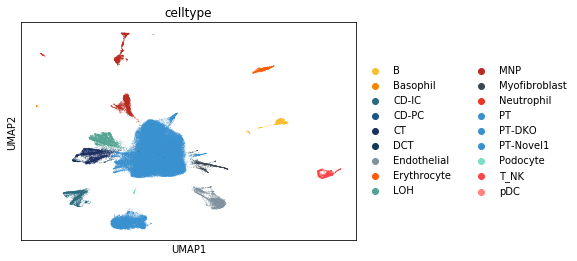

In [4]:
sc.pl.umap(adata, color = ['celltype'])

In [2]:
# use paga to reinitialise umap
sc.tl.paga(adata)
sc.pl.paga(adata, plot=False)  # remove `plot=False` if you want to see the coarse-grained graph

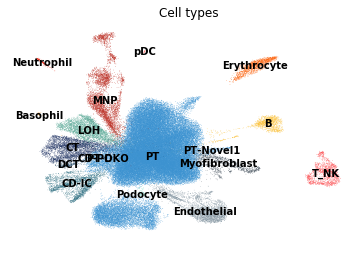

In [2]:
sc.tl.umap(adata, init_pos='paga', n_components = 2, min_dist = 0.8)
sc.pl.umap(adata, color = ['celltype'], palette = ['#FABD2E', '#F58700', '#296B7E', '#1C5389', '#1D3061', '#113A5B', '#80929E', '#FC5C03', '#53A592', '#B92A1F', '#3B4854', '#EC3624', '#3A91D0', '#3A91D0', '#3A91D0', '#7ADFC4', '#FB4649', '#FF837F'], frameon = False,  legend_loc = 'on data', title = 'Cell types')

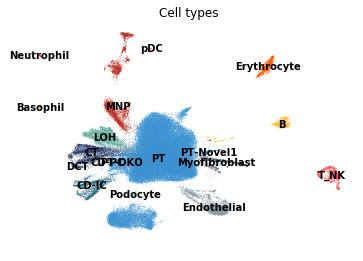

In [4]:
sc.tl.umap(adata, init_pos='paga', n_components = 2, min_dist = 0.5)
sc.pl.umap(adata, color = ['celltype'], palette = ['#FABD2E', '#F58700', '#296B7E', '#1C5389', '#1D3061', '#113A5B', '#80929E', '#FC5C03', '#53A592', '#B92A1F', '#3B4854', '#EC3624', '#3A91D0', '#3A91D0', '#3A91D0', '#7ADFC4', '#FB4649', '#FF837F'], frameon = False,  legend_loc = 'on data', title = 'Cell types')

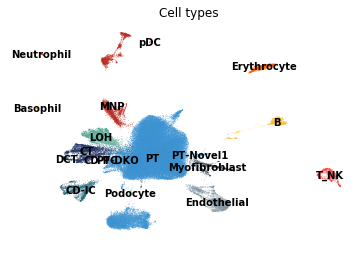

In [5]:
sc.tl.umap(adata, init_pos='paga', n_components = 2, min_dist = 0.4)
sc.pl.umap(adata, color = ['celltype'], palette = ['#FABD2E', '#F58700', '#296B7E', '#1C5389', '#1D3061', '#113A5B', '#80929E', '#FC5C03', '#53A592', '#B92A1F', '#3B4854', '#EC3624', '#3A91D0', '#3A91D0', '#3A91D0', '#7ADFC4', '#FB4649', '#FF837F'], frameon = False,  legend_loc = 'on data', title = 'Cell types')

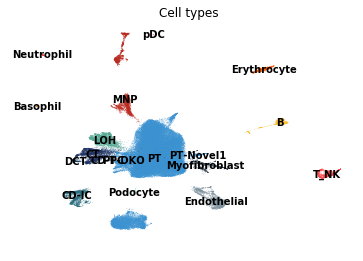

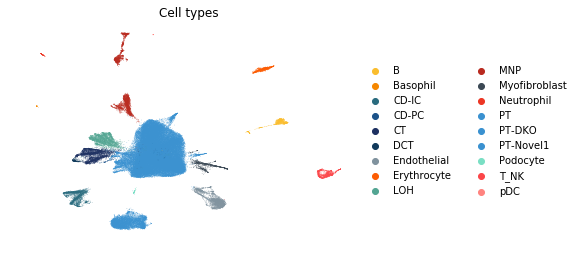

In [6]:
sc.tl.umap(adata, init_pos='paga', n_components = 2, min_dist = 0.3)
sc.pl.umap(adata, color = ['celltype'], palette = ['#FABD2E', '#F58700', '#296B7E', '#1C5389', '#1D3061', '#113A5B', '#80929E', '#FC5C03', '#53A592', '#B92A1F', '#3B4854', '#EC3624', '#3A91D0', '#3A91D0', '#3A91D0', '#7ADFC4', '#FB4649', '#FF837F'], frameon = False,  legend_loc = 'on data', title = 'Cell types')
sc.pl.umap(adata, color = ['celltype'], palette = ['#FABD2E', '#F58700', '#296B7E', '#1C5389', '#1D3061', '#113A5B', '#80929E', '#FC5C03', '#53A592', '#B92A1F', '#3B4854', '#EC3624', '#3A91D0', '#3A91D0', '#3A91D0', '#7ADFC4', '#FB4649', '#FF837F'], frameon = False, title = 'Cell types', save = '/All_celltypes.pdf')

In [9]:
# save the new embedding
adata.write(results_file, compression = 'gzip')

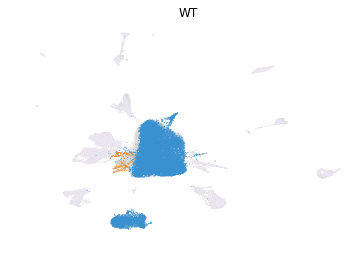

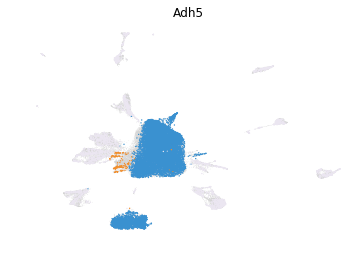

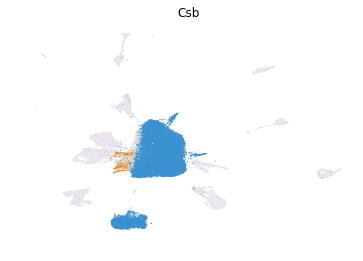

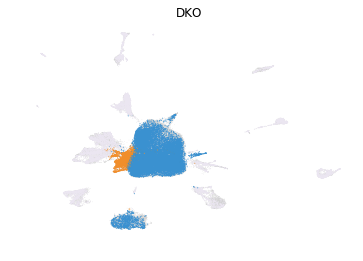

In [12]:
for x in ['WT', 'Adh5', 'Csb', 'DKO']:
    ax = sc.pl.umap(adata, show=False)
    sc.pl.umap(adata[adata.obs["group"] == x], color = ['celltype'], palette = ['#ece7f2','#ece7f2','#ece7f2','#ece7f2','#ece7f2','#ece7f2','#ece7f2','#ece7f2','#ece7f2','#ece7f2','#ece7f2','#ece7f2','#3A91D0','#F28E2b','#3A91D0','#ece7f2','#ece7f2','#ece7f2'],  ax = ax, legend_loc = None, frameon = False, title = str(x))

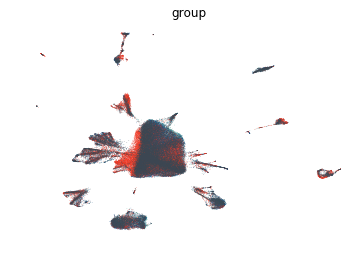

In [3]:
for x in ['WT', 'Adh5', 'Csb', 'DKO']:
# also plot what the groups are like now
sc.pl.umap(adata, color = ['group'], legend_loc = None, frameon = False, save = '/All_group_umap.pdf')


In [5]:
# rerun the top deg for pt
sc.tl.rank_genes_groups(pt, groupby='pt_celltype', method='wilcoxon', n_genes=30000)

In [ ]:
import numpy as np
import pandas as pd
import scanpy as sc
import scrublet as scr
import os
import warnings
import functools
import seaborn as sns
import scipy.stats
import anndata
import multiprocessing

warnings.filterwarnings('ignore')
os.chdir(os.path.expanduser('/home/jovyan/Lee_KJ_Kidney_10x_sep19/scanpy'))

pt_file = 'out/Lee_Sept_new_pt.h5ad'

pt = sc.read_h5ad(pt_file)

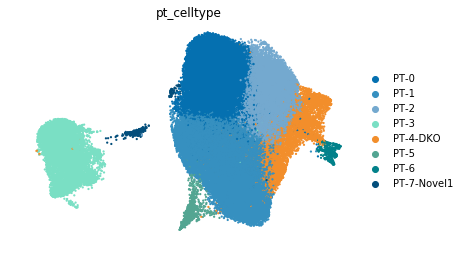

In [5]:
sc.pl.umap(pt, color = ['pt_celltype'], palette = ['#0570b0', '#3690c0', '#74a9cf', '#7ADFC4', '#F28E2b', '#53A592', '#02818a', '#034e7b'], frameon = False, size = 20)

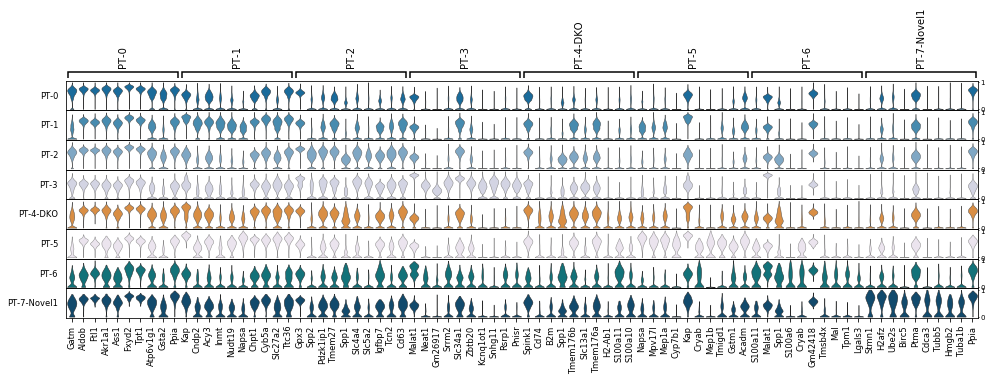

In [24]:
# for some reason, the colouring order is weird
sc.pl.rank_genes_groups_stacked_violin(pt, groupby='pt_celltype', 
                                        n_genes=10, 
                                        dendrogram = False,
                                        standard_scale = 'var',
                                        row_palette = (
                                            '#02818a', #pt6 pos7
                                            '#034e7b', #pt7 pos8
                                            '#0570b0', #pt0 pos1                                           
                                            '#3690c0', #pt1 pos2
                                            '#74a9cf', #pt2 pos3
                                            '#d0d1e6', #pt3 pos4
                                            '#F28E2b', #pt4 pos5
                                            '#ece2f0' #pt5 post6
                                        ))

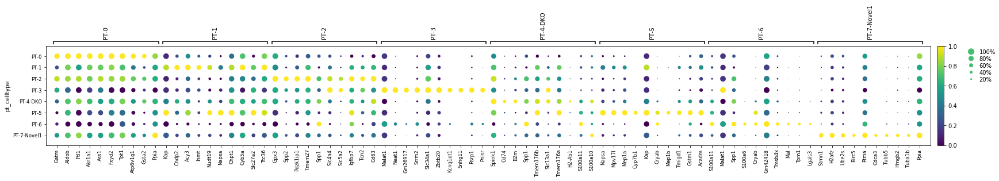

In [13]:
sc.pl.rank_genes_groups_dotplot(pt, groupby='pt_celltype', 
                                    n_genes=10, 
                                    dendrogram = False,
                                    standard_scale = 'var',
                                    color_map = 'viridis')

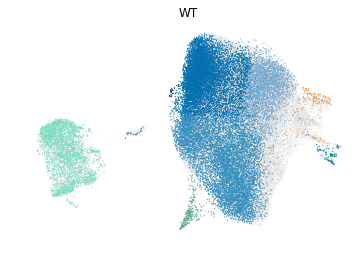

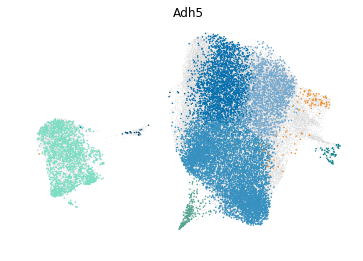

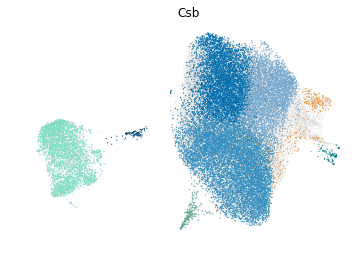

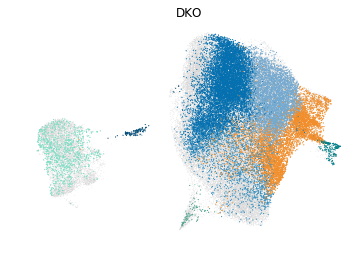

In [6]:
for x in ['WT', 'Adh5', 'Csb', 'DKO']:
    ax = sc.pl.umap(pt, show=False)
    sc.pl.umap(pt[pt.obs["group"] == x], color = ['pt_celltype'], ax = ax, legend_loc = None, frameon = False, title = str(x), save = '/PT_celltypes_'+str(x)+'.pdf')

In [1]:
import numpy as np
import pandas as pd
import scanpy as sc
import scrublet as scr
import os
import warnings
import functools
import seaborn as sns
import scipy.stats
import anndata
import multiprocessing

warnings.filterwarnings('ignore')
os.chdir(os.path.expanduser('/home/jovyan/Lee_KJ_Kidney_10x_sep19/scanpy'))

pt_file = 'out/Lee_Sept_new_pt.h5ad'

pt = sc.read_h5ad(pt_file)

/home/jovyan/my-conda-envs/mypython3/lib/python3.7/site-packages/dask/config.py:161: YAMLLoadWarning: calling yaml.load() without Loader=... is deprecated, as the default Loader is unsafe. Please read https://msg.pyyaml.org/load for full details.
  data = yaml.load(f.read()) or {}


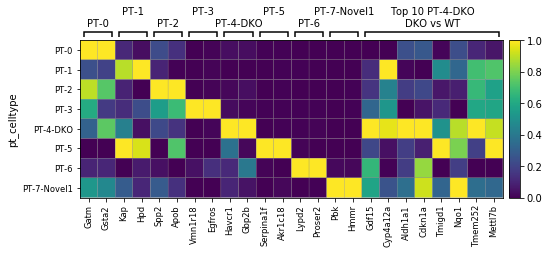

In [2]:
if not os.path.exists('figures/matrixplot'):
    os.makedirs('figures/matrixplot')
top2 = {'PT-0':['Gatm', 'Gsta2'],
    'PT-1\n':['Kap', 'Hpd'],
    'PT-2':['Spp2', 'Apob'],
    'PT-3\n':['Vmn1r18', 'Egfros'],
    'PT-4-DKO':['Havcr1', 'Gbp2b'],
    'PT-5\n':['Serpina1f','Akr1c18'],
    'PT-6':['Lypd2', 'Proser2'],
    'PT-7-Novel1\n':['Pbk', 'Hmmr'],
    'Top 10 PT-4-DKO\nDKO vs WT':['Gdf15', 'Cyp4a12a', 'Aldh1a1', 'Cdkn1a','Tmigd1', 'Nqo1', 'Tmem252', 'Mettl7b']}
ax = sc.pl.matrixplot(pt, top2, groupby='pt_celltype', standard_scale = 'var', cmap = 'viridis', var_group_rotation = 0, save = '/PT_topgenes.pdf')

In [54]:
pd.crosstab(pt.obs['pt_celltype'], pt.obs['group'])

group,Adh5,Csb,DKO,WT
pt_celltype,,,,
PT-0,2550,5717,8766,8941
PT-1,6480,9044,1926,8332
PT-2,1775,4095,4893,3015
PT-3,1825,2886,964,2650
PT-4-DKO,129,374,5246,182
PT-5,230,209,93,273
PT-6,56,77,207,87
PT-7-Novel1,23,118,120,60


In [55]:
pd.crosstab(adata.obs['celltype'], adata.obs['group'])

group,Adh5,Csb,DKO,WT
celltype,,,,
B,226,400,500,277
Basophil,4,8,6,14
CD-IC,242,699,855,871
CD-PC,12,36,2,30
CT,461,989,1166,1335
DCT,47,97,55,128
Endothelial,528,1262,574,1341
Erythrocyte,118,405,151,823
LOH,337,978,974,1305


In [1]:
import numpy as np
import pandas as pd
import scanpy as sc
import scrublet as scr
import os
import warnings
import functools
import seaborn as sns
import scipy.stats
import anndata
import multiprocessing

warnings.filterwarnings('ignore')
os.chdir(os.path.expanduser('/home/jovyan/Lee_KJ_Kidney_10x_sep19/scanpy'))

pt_file = 'out/Lee_Sept_new_pt.h5ad'
results_file = 'out/Lee_Sept_new.h5ad'

pt = sc.read_h5ad(pt_file)
adata = sc.read_h5ad(results_file)

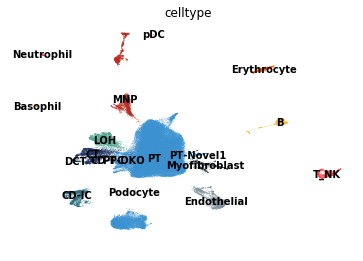

In [2]:
sc.pl.umap(adata, color = ['celltype'], frameon = False, legend_loc = 'on data')

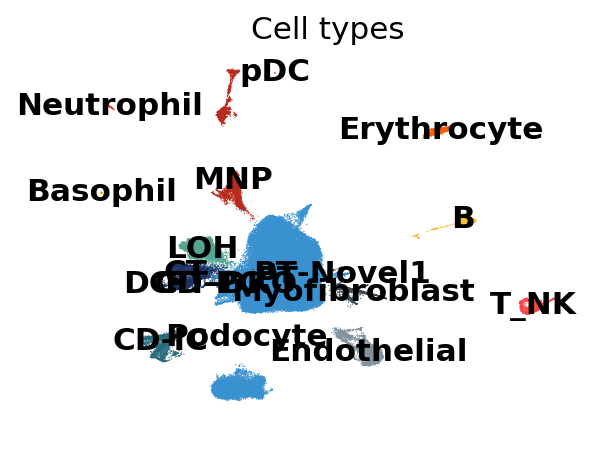

In [3]:
# instead of saving all the dots as vector, i will just save it as a rasterized version, with a reasonably high save dpi
sc.set_figure_params(figsize = [4.0, 3.0], vector_friendly = True, dpi_save = 6400)
sc.pl.umap(adata, color = ['celltype'], frameon = False, legend_loc = 'on data', title = 'Cell types', save = '/All_celltypes.pdf')

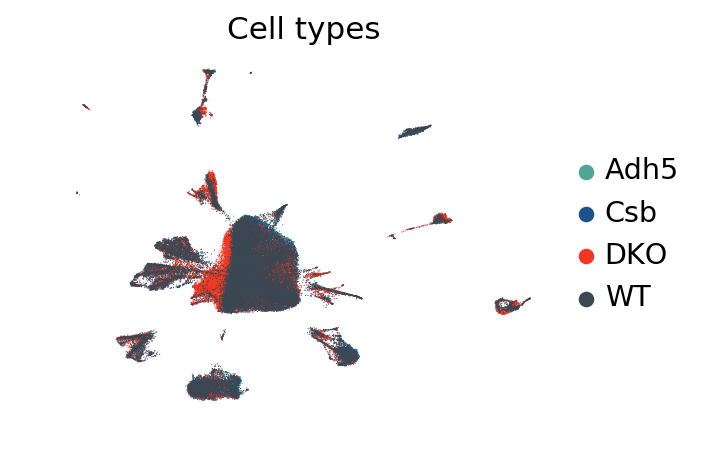

In [5]:
sc.pl.umap(adata, color = ['group'], frameon = False, title = 'Cell types', save = '/All_group_umap.pdf')

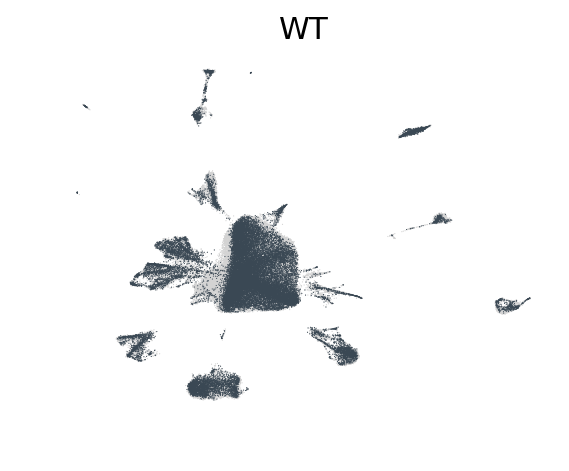

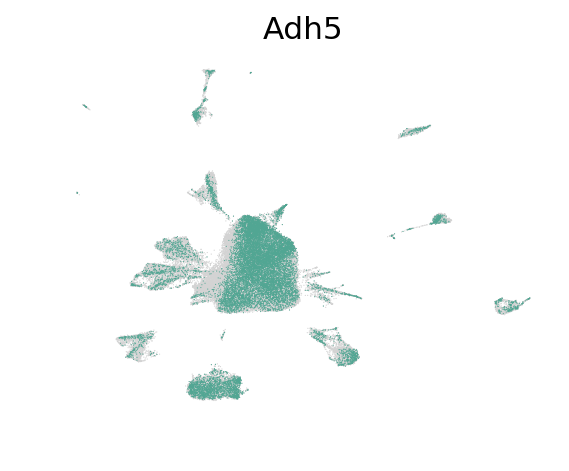

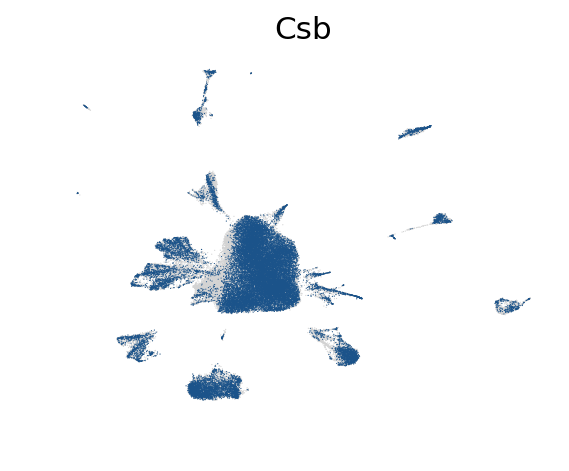

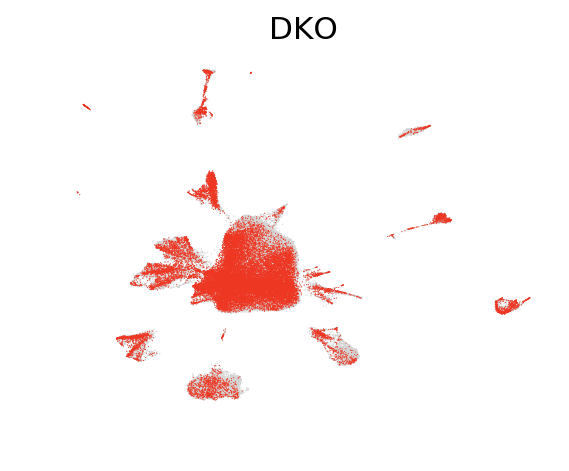

In [3]:
sc.set_figure_params(figsize = [4.0, 3.0], vector_friendly = True, dpi_save = 1600)
for x in ['WT', 'Adh5', 'Csb', 'DKO']:
    ax = sc.pl.umap(adata, show=False)
    sc.pl.umap(adata[adata.obs["group"] == x], color = ['group'], ax = ax, size = 1, legend_loc = None, frameon = False, title = str(x), save = '/All_group_'+str(x)+'.pdf')

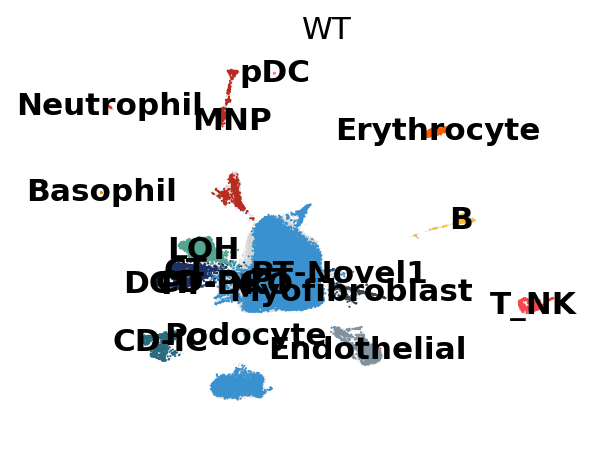

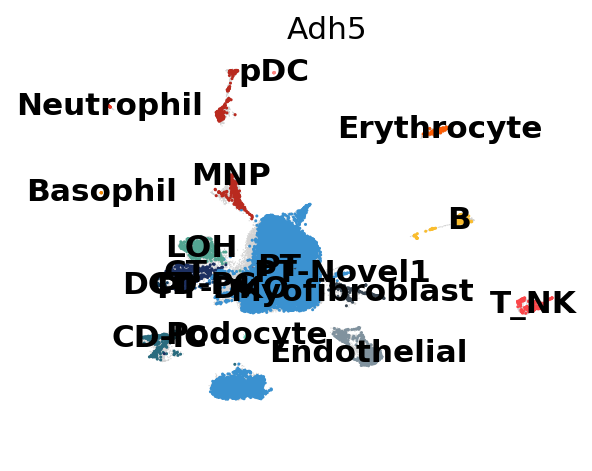

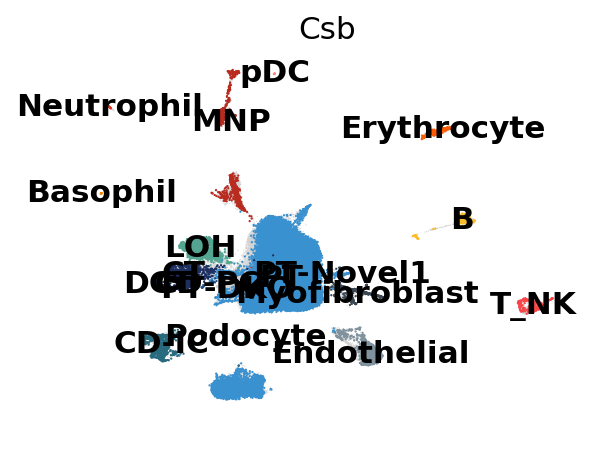

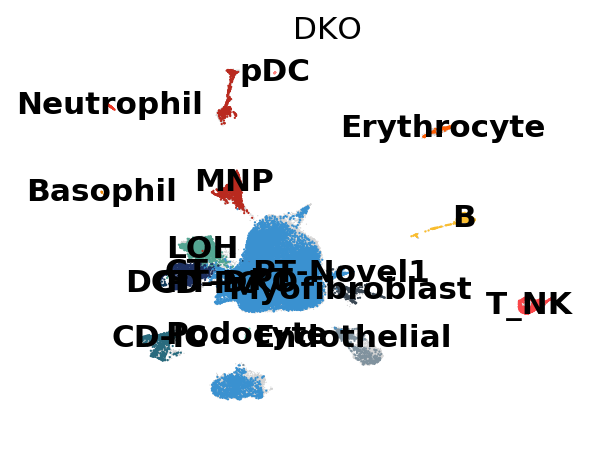

In [2]:
sc.set_figure_params(figsize = [4.0, 3.0], vector_friendly = True, dpi_save = 1600)
for x in ['WT', 'Adh5', 'Csb', 'DKO']:
    ax = sc.pl.umap(adata, show=False)
    sc.pl.umap(adata[adata.obs["group"] == x], color = ['celltype'],  ax = ax, legend_loc = 'on data', frameon = False, title = str(x), save = '/All_celltypes_'+str(x)+'.pdf')

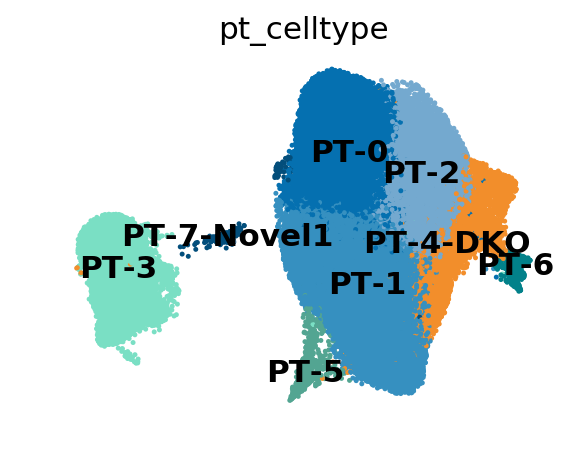

In [6]:
sc.pl.umap(pt, color = ['pt_celltype'], palette = ['#0570b0', '#3690c0', '#74a9cf', '#7ADFC4', '#F28E2b', '#53A592', '#02818a', '#034e7b'], legend_loc = 'on data', frameon = False, size = 20, save = '/Proximal_tubules_umap.pdf')

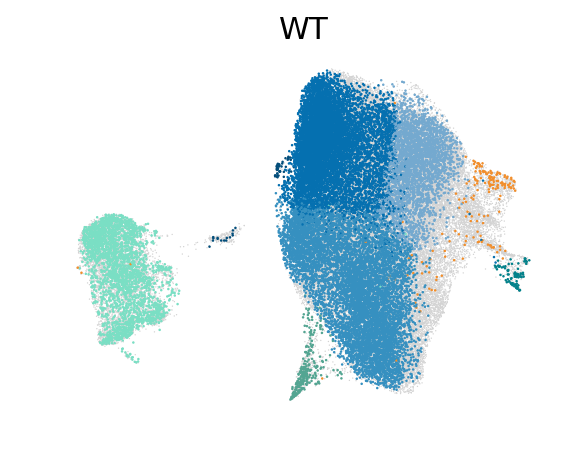

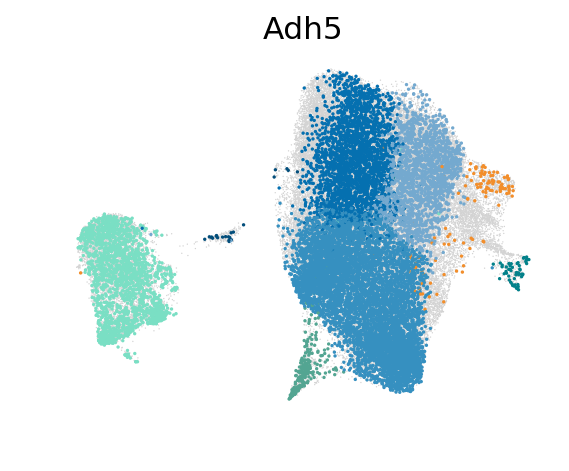

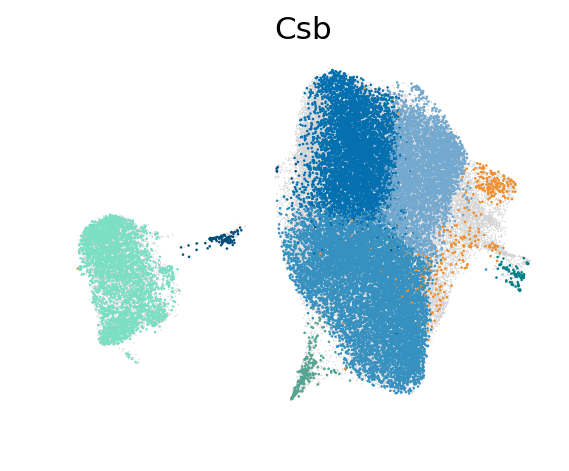

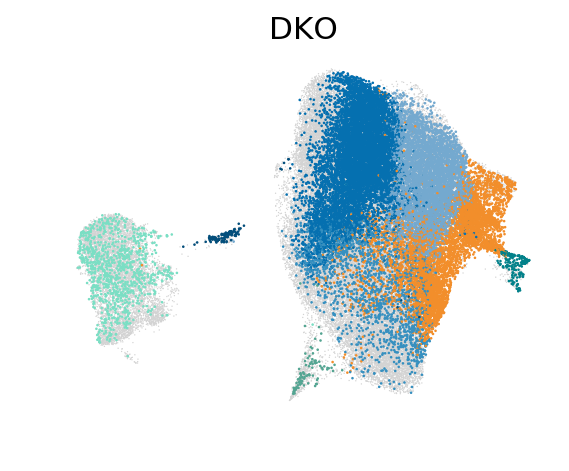

In [12]:
sc.set_figure_params(figsize = [4.0, 3.0], vector_friendly = True, dpi_save = 1600)
for x in ['WT', 'Adh5', 'Csb', 'DKO']:
    ax = sc.pl.umap(pt, show=False)
    sc.pl.umap(pt[pt.obs["group"] == x], color = ['pt_celltype'], ax = ax, legend_loc = None, frameon = False, title = str(x), save = '/PT_celltypes_'+str(x)+'.pdf')

In [8]:
adata.uns['group_colors']

['#51a693', '#1b538a', '#ef3723', '#3a4854']

In [1]:
import numpy as np
import pandas as pd
import scanpy as sc
import scrublet as scr
import os
import warnings
import functools
import seaborn as sns
import scipy.stats
import anndata
import multiprocessing

warnings.filterwarnings('ignore')
os.chdir(os.path.expanduser('/home/jovyan/Lee_KJ_Kidney_10x_sep19/scanpy'))

pt_file = 'out/Lee_Sept_new_pt.h5ad'

pt = sc.read_h5ad(pt_file)

In [8]:
import math

In [14]:
0.85 * pt.raw.X[:,int(np.where(pt.raw.var.index == 'Havcr1')[0])].max()

3.2632959008216855

In [15]:
0.85 * pt.raw.X[:,int(np.where(pt.raw.var.index == 'Cdkn1a')[0])].max()

3.9220595598220824

In [16]:
0.85 * pt.raw.X[:,int(np.where(pt.raw.var.index == 'Gdf15')[0])].max()

3.6384431838989255

In [2]:
# sc.set_figure_params(figsize = [4.0, 3.0], vector_friendly = True, dpi_save = 900)
# for x in ['WT', 'Adh5', 'Csb', 'DKO']:
#     # ax = sc.pl.umap(pt, show=False)
#     sc.pl.umap(pt[pt.obs["group"] == x], color = ['Havcr1', 'Cdkn1a', 'Gdf15'], color_map = 'viridis', size=20, frameon=False, vmax = [3.8391716, 4.6141877, 4.2805214], save='/Lee_'+str(x)+'_damage_markers_umap.pdf')

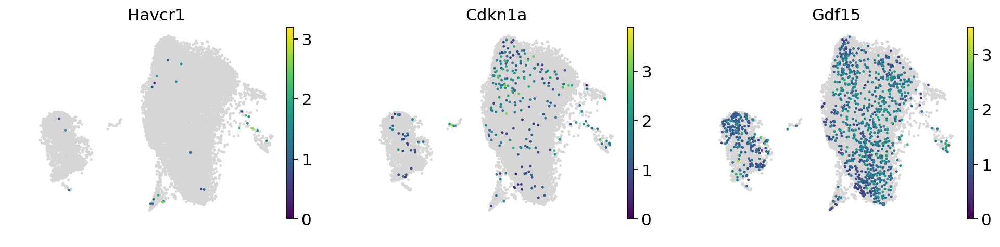

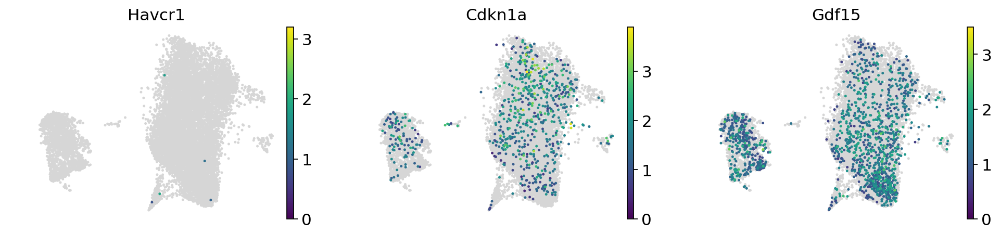

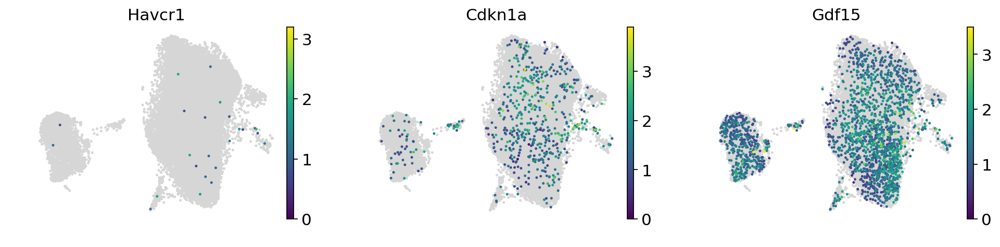

In [ ]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import functools
from matplotlib import cm
from matplotlib.colors import ListedColormap, LinearSegmentedColormap

# create a palette for umap
def cmp(palette='viridis'):
    viridis = cm.get_cmap(palette, 256)
    newcolors = viridis(np.linspace(0, 1, 256))
    grey = np.array([215/256, 215/256, 215/256, 1])
    newcolors[:1, :] = grey
    newcmp = ListedColormap(newcolors)
    return(newcmp)

newcmp = cmp()
sc.set_figure_params(figsize = [4.0, 3.0], vector_friendly = True, dpi_save = 900)
for x in ['WT', 'Adh5', 'Csb', 'DKO']:
    # ax = sc.pl.umap(pt, show=False)
    # sc.pl.umap(pt[pt.obs["group"] == x], color = ['Havcr1', 'Cdkn1a', 'Gdf15'], color_map = newcmp, size=20, frameon=False, vmax = [3.8391716, 4.6141877, 4.2805214], save='/Lee_'+str(x)+'_damage_markers_umap_with_grey.pdf')
        sc.pl.umap(pt[pt.obs["group"] == x], color = ['Havcr1', 'Cdkn1a', 'Gdf15'], color_map = newcmp, size=20, frameon=False, vmax = [3.2, 3.9, 3.5], save='/Lee_'+str(x)+'_damage_markers_umap_with_grey.pdf')

In [1]:
import numpy as np
import pandas as pd
import scanpy as sc
import scrublet as scr
import os
import warnings
import functools
import seaborn as sns
import scipy.stats
import anndata
import multiprocessing
import matplotlib
matplotlib.rcParams['pdf.fonttype'] = 42
matplotlib.rcParams['ps.fonttype'] = 42

warnings.filterwarnings('ignore')
os.chdir(os.path.expanduser('/home/jovyan/Lee_KJ_Kidney_10x_sep19/scanpy'))

pt_file = 'out/Lee_Sept_new_pt.h5ad'

adata = sc.read_h5ad(pt_file)
adata

/home/jovyan/my-conda-envs/mypython3/lib/python3.7/site-packages/dask/config.py:161: YAMLLoadWarning: calling yaml.load() without Loader=... is deprecated, as the default Loader is unsafe. Please read https://msg.pyyaml.org/load for full details.
  data = yaml.load(f.read()) or {}


AnnData object with n_obs × n_vars = 81343 × 894 
    obs: 'batch', 'group', 'sample', 'scrublet_score', 'scrublet_cluster_score', 'bh_pval', 'is_doublet', 'n_genes', 'percent_mito', 'n_counts', 'S_score', 'G2M_score', 'phase', 'leiden', 'Park_Endo_score', 'Park_Peri_score', 'Park_Podo_score', 'Park_PCT-S1_score', 'Park_PT-S2_score', 'Park_PST-S3_score', 'Park_DLH_score', 'Park_LOH_score', 'Park_DCT_score', 'Park_CD-IC-A_score', 'Park_CD-IC-B_score', 'Park_CD-Trans_score', 'Park_CD-PC_score', 'Park_Fibro_score', 'Park_Macro_score', 'Park_Neutro_score', 'Park_Bcell_score', 'Park_Tcell_score', 'Park_NKcell_score', 'Park_Novel1_score', 'Park_Novel2_score', 'celltype', 'leiden_pt', 'pt_celltype'
    var: 'gene_ids', 'feature_types', 'n_cells', 'highly_variable', 'means', 'dispersions', 'dispersions_norm'
    uns: 'celltype_colors', 'dendrogram_celltype', 'dendrogram_leiden', 'dendrogram_leiden_pt', 'group_colors', 'leiden', 'leiden_colors', 'leiden_pt_colors', 'leiden_sizes', 'neighbors', 

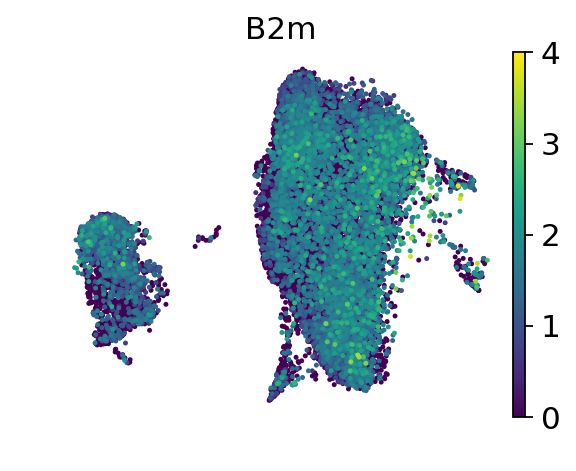

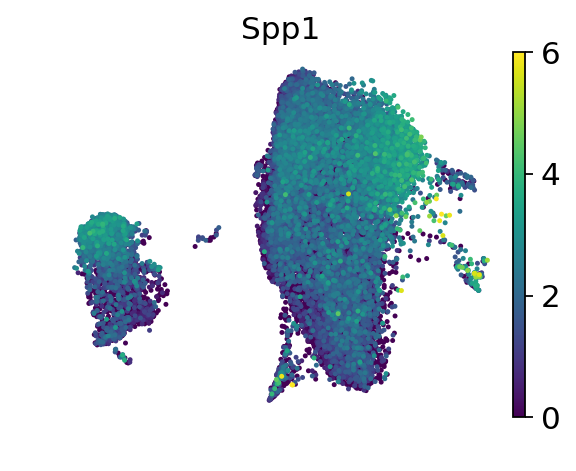

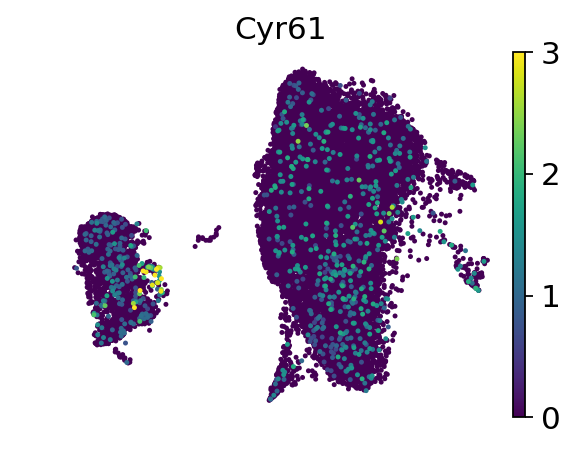

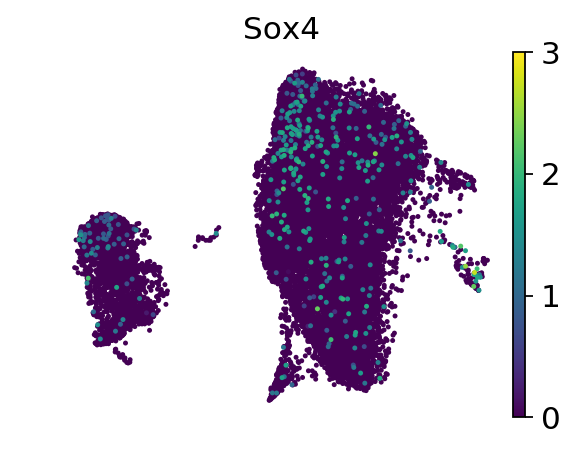

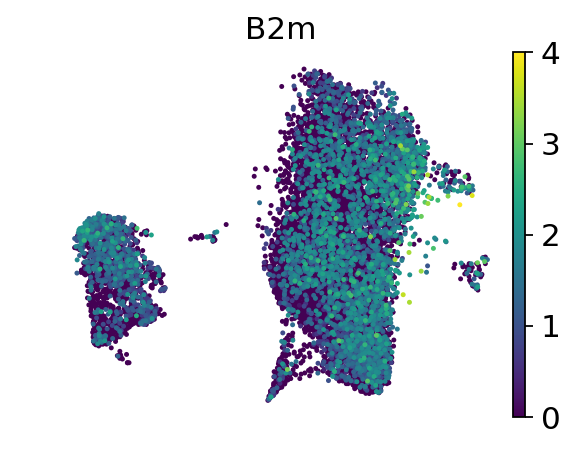

...

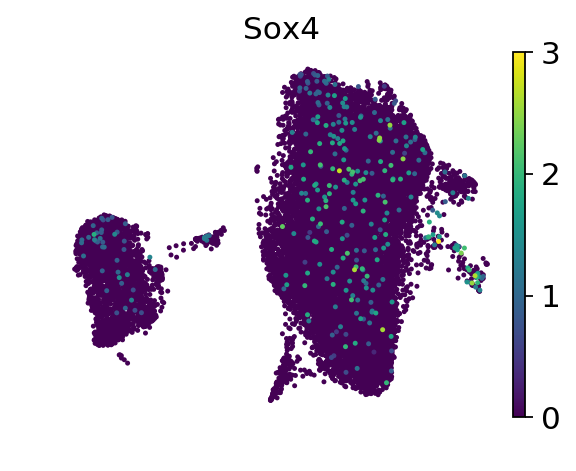

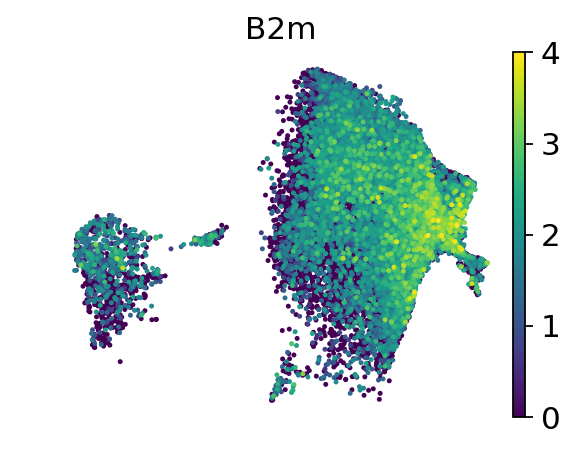

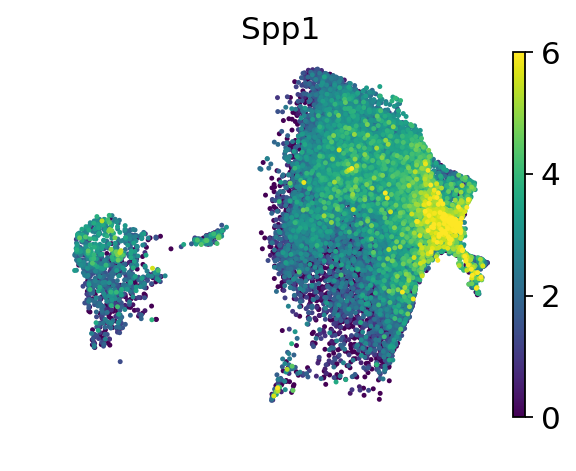

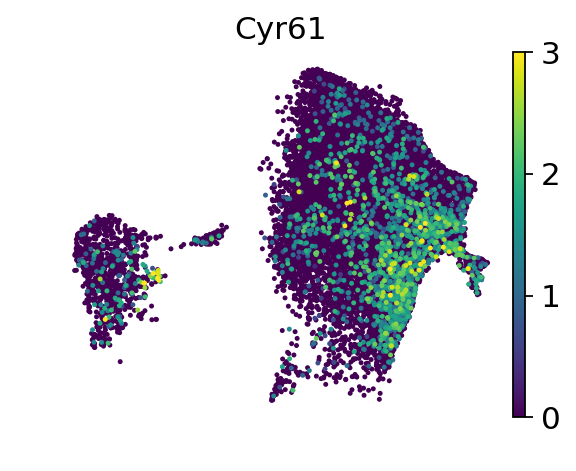

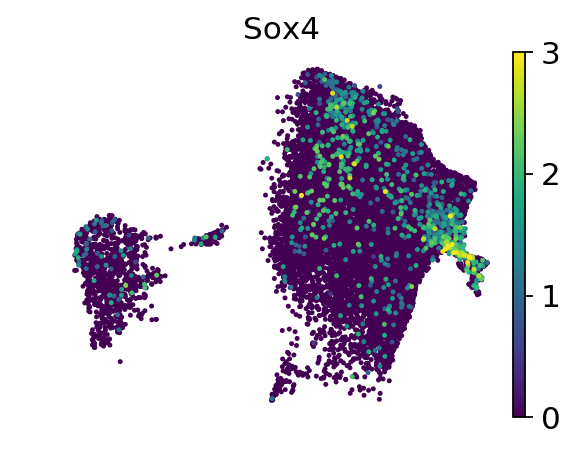

In [4]:
sc.set_figure_params(figsize = [4.0, 3.0], vector_friendly = True, dpi_save = 600)
for x in ['WT', 'Adh5', 'Csb', 'DKO']:
    # ax = sc.pl.umap(pt, show=False)
    sc.pl.umap(adata[adata.obs["group"] == x], color = ['B2m'], vmax = 4, color_map = 'viridis', size=20, frameon=False, save='/Lee_'+str(x)+'_B2m_umap.pdf')
    sc.pl.umap(adata[adata.obs["group"] == x], color = ['Spp1'], vmax = 6, color_map = 'viridis', size=20, frameon=False, save='/Lee_'+str(x)+'_Spp1_umap.pdf')
    sc.pl.umap(adata[adata.obs["group"] == x], color = ['Cyr61'], vmax = 3, color_map = 'viridis', size=20, frameon=False, save='/Lee_'+str(x)+'_Cyr61_umap.pdf')
    sc.pl.umap(adata[adata.obs["group"] == x], color = ['Sox4'], vmax = 3, color_map = 'viridis', size=20, frameon=False, save='/Lee_'+str(x)+'_Sox4_umap.pdf')

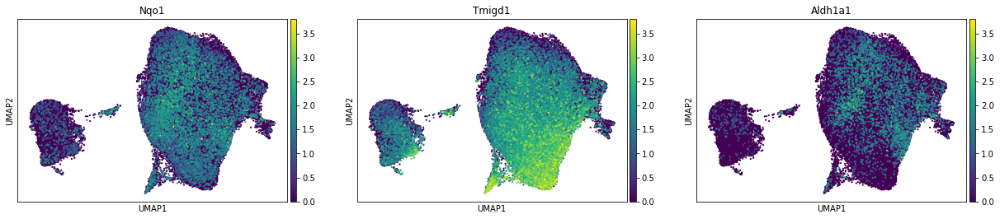

In [5]:
sc.pl.umap(adata, color = ['Nqo1', 'Tmigd1', 'Aldh1a1'], size =20, vmax = 3.8)

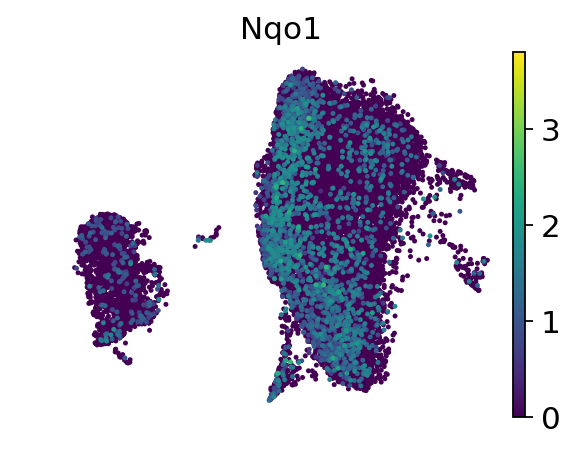

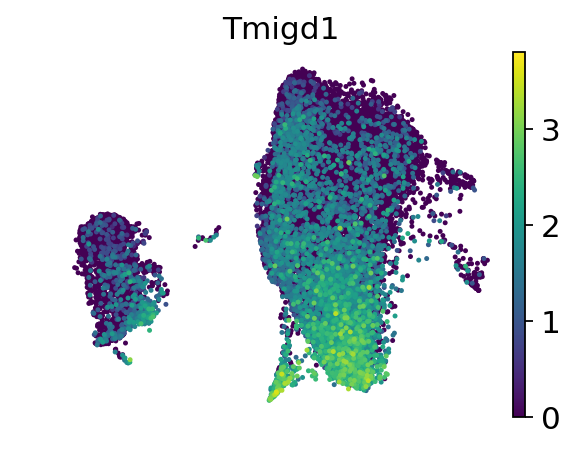

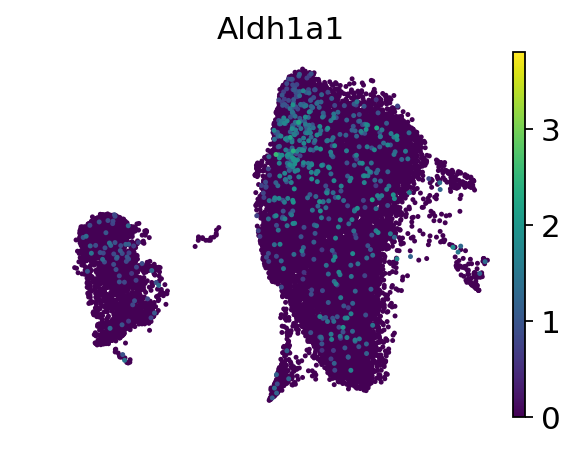

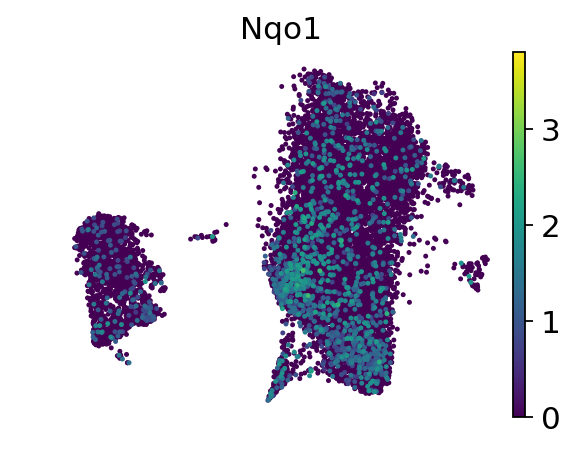

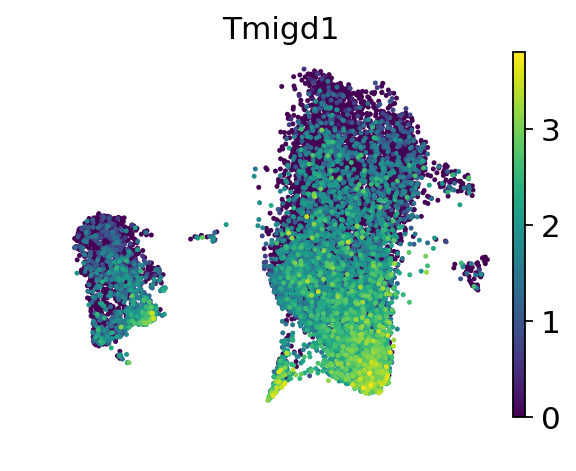

...

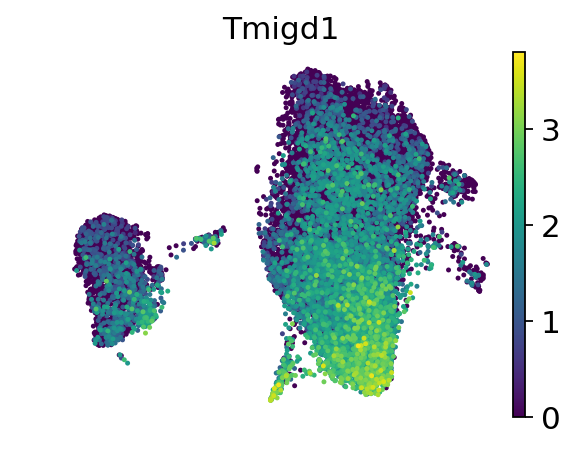

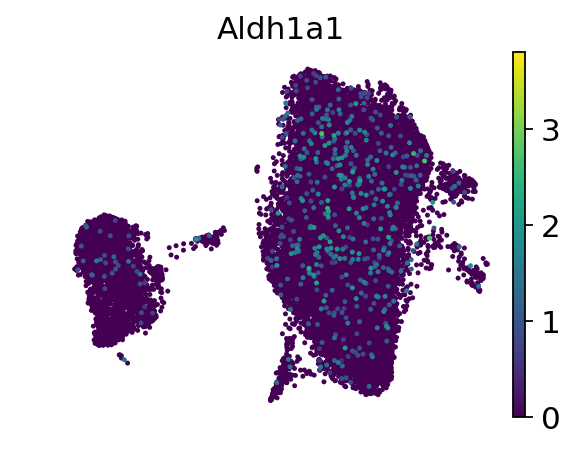

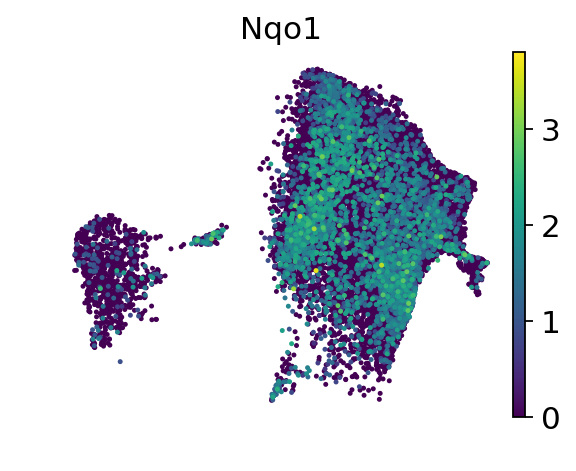

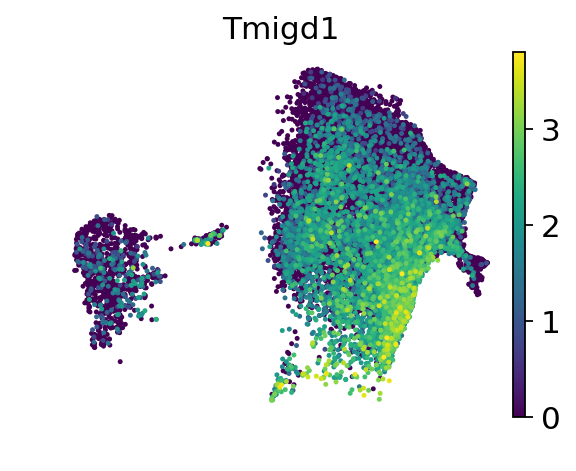

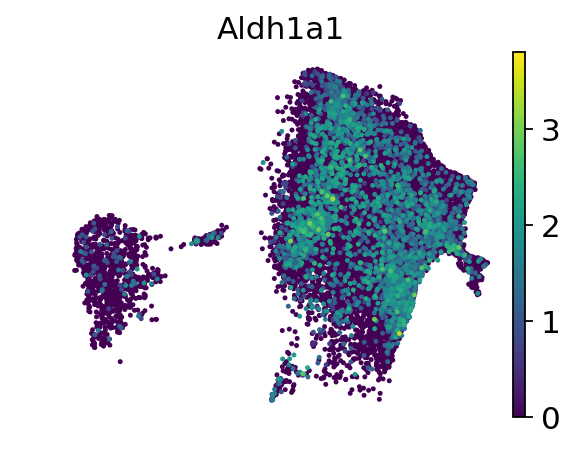

In [6]:
sc.set_figure_params(figsize = [4.0, 3.0], vector_friendly = True, dpi_save = 600)
for x in ['WT', 'Adh5', 'Csb', 'DKO']:
    # ax = sc.pl.umap(pt, show=False)
    sc.pl.umap(adata[adata.obs["group"] == x], color = ['Nqo1'], vmax = 3.8, color_map = 'viridis', size=20, frameon=False, save='/Lee_'+str(x)+'_Nqo1_umap.pdf')
    sc.pl.umap(adata[adata.obs["group"] == x], color = ['Tmigd1'], vmax = 3.8, color_map = 'viridis', size=20, frameon=False, save='/Lee_'+str(x)+'_Tmigd1_umap.pdf')
    sc.pl.umap(adata[adata.obs["group"] == x], color = ['Aldh1a1'], vmax = 3.8, color_map = 'viridis', size=20, frameon=False, save='/Lee_'+str(x)+'_Aldh1a1_umap.pdf')

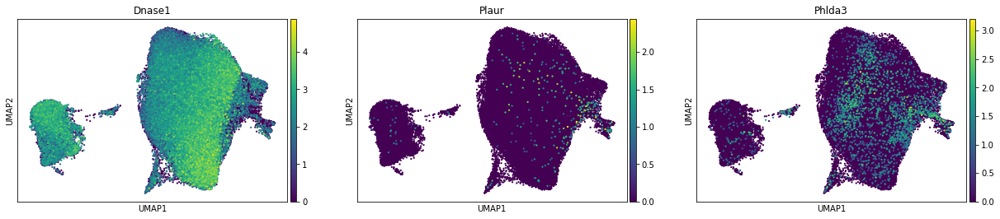

In [2]:
sc.pl.umap(adata, color = ['Dnase1', 'Plaur', 'Phlda3'], size =20)

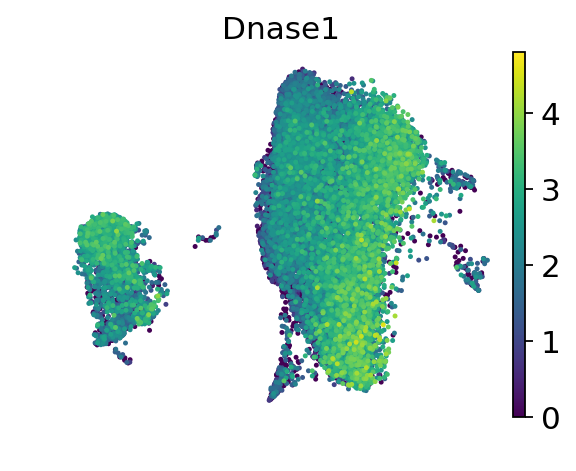

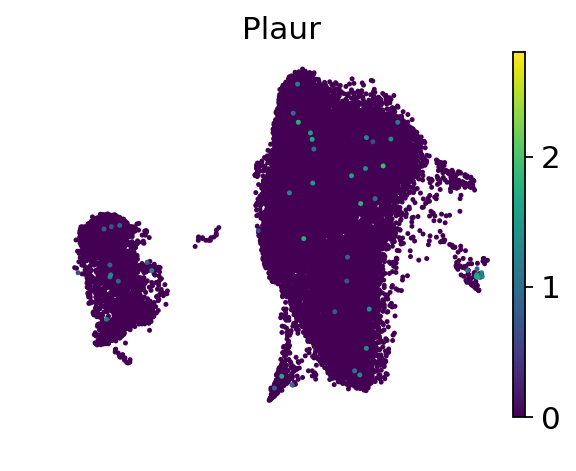

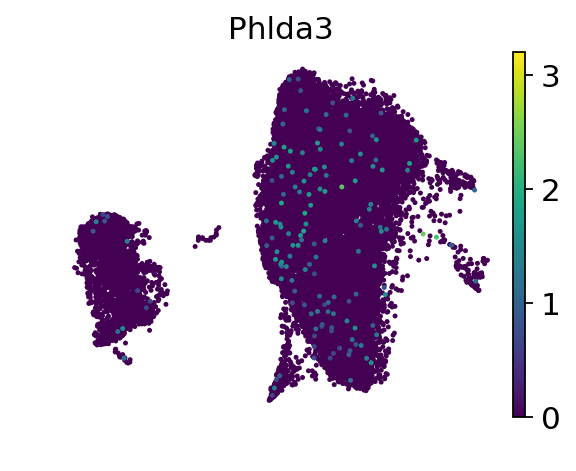

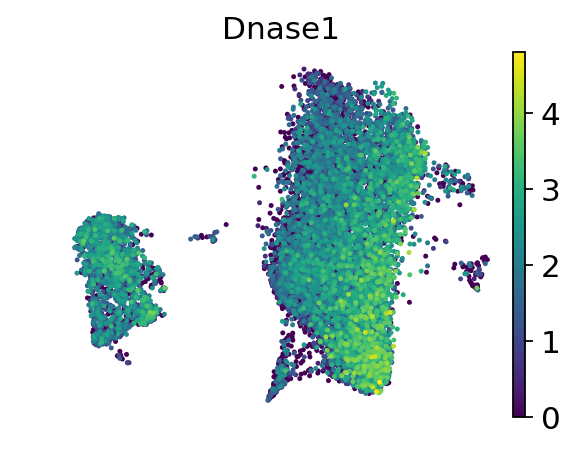

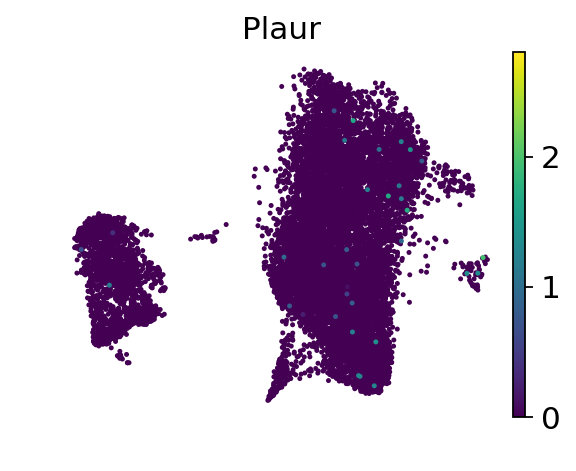

...

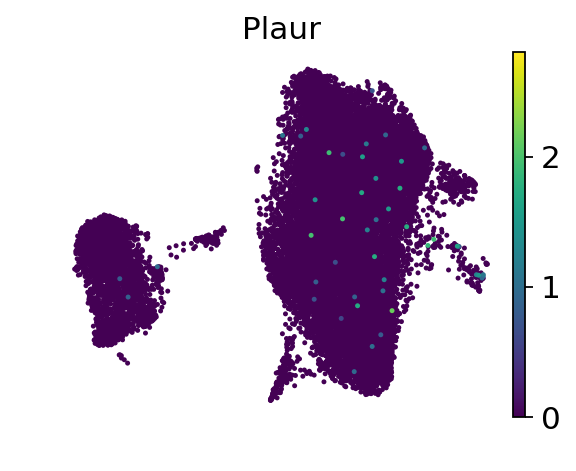

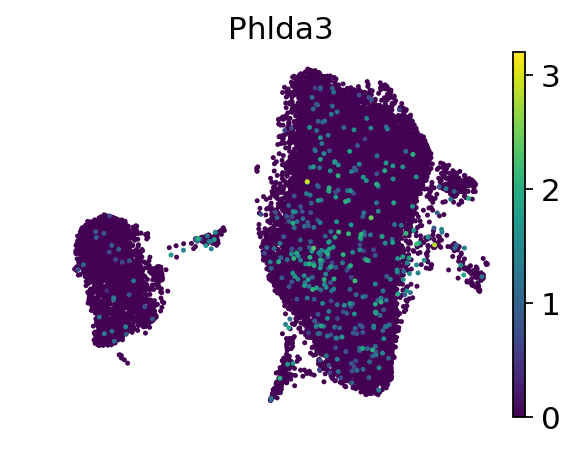

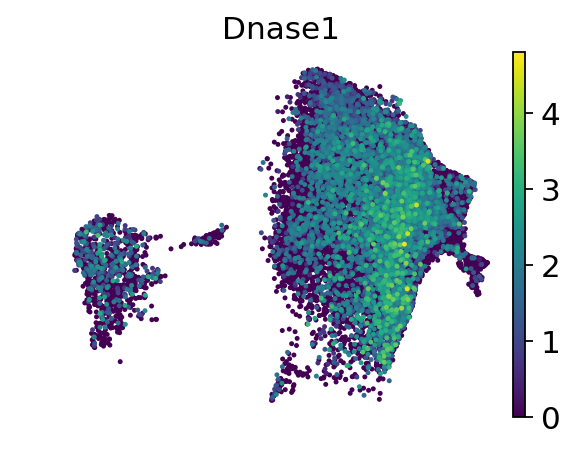

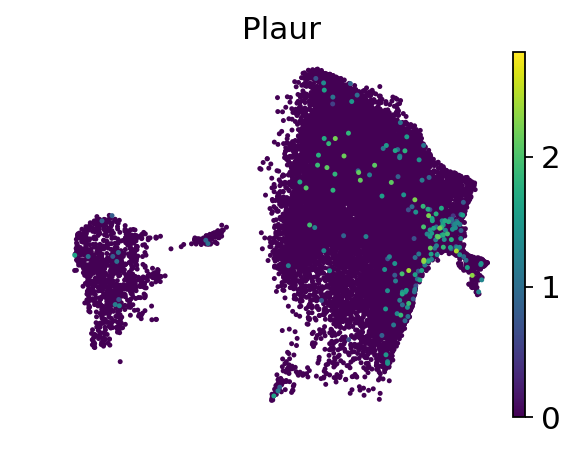

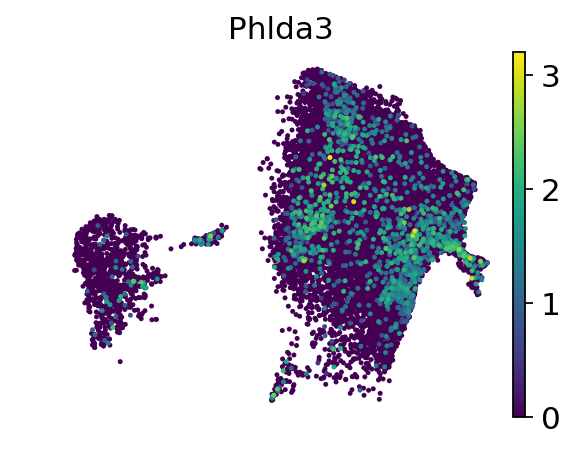

In [4]:
sc.set_figure_params(figsize = [4.0, 3.0], vector_friendly = True, dpi_save = 600)
for x in ['WT', 'Adh5', 'Csb', 'DKO']:
    # ax = sc.pl.umap(pt, show=False)
    sc.pl.umap(adata[adata.obs["group"] == x], color = ['Dnase1'], vmax = 4.8, color_map = 'viridis', size=20, frameon=False, save='/Lee_'+str(x)+'_Dnase1_umap.pdf')
    sc.pl.umap(adata[adata.obs["group"] == x], color = ['Plaur'], vmax = 2.8, color_map = 'viridis', size=20, frameon=False, save='/Lee_'+str(x)+'_Plaur1_umap.pdf')
    sc.pl.umap(adata[adata.obs["group"] == x], color = ['Phlda3'], vmax = 3.2, color_map = 'viridis', size=20, frameon=False, save='/Lee_'+str(x)+'_Phlda3_umap.pdf')

In [1]:
import numpy as np
import pandas as pd
import scanpy as sc
import scrublet as scr
import os
import warnings
import functools
import seaborn as sns
import scipy.stats
import anndata
import multiprocessing

warnings.filterwarnings('ignore')
os.chdir(os.path.expanduser('/home/jovyan/Lee_KJ_Kidney_10x_sep19/scanpy'))

res_file = 'out/Lee_Sept_new.h5ad'

adata = sc.read_h5ad(res_file)

/home/jovyan/my-conda-envs/mypython3/lib/python3.7/site-packages/dask/config.py:161: YAMLLoadWarning: calling yaml.load() without Loader=... is deprecated, as the default Loader is unsafe. Please read https://msg.pyyaml.org/load for full details.
  data = yaml.load(f.read()) or {}


Trying to set attribute `.uns` of view, making a copy.


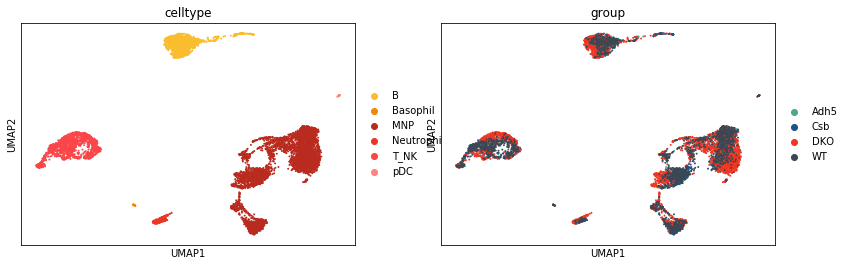

In [2]:
imm = adata[adata.obs['celltype'].isin(['MNP', 'pDC', 'T_NK', 'Neutrophil', 'Basophil', 'B'])]
sc.tl.umap(imm, min_dist=0.3)
sc.pl.umap(imm, color = ['celltype', 'group'])

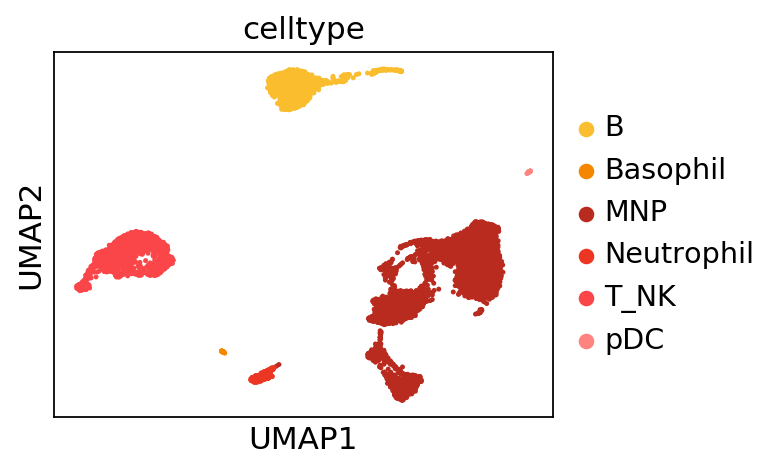

In [3]:
sc.set_figure_params(figsize = [4.0, 3.0], vector_friendly = True, dpi_save = 900)
sc.pl.umap(imm, color = ['celltype'], size =20, save = '/immune_umap.df')

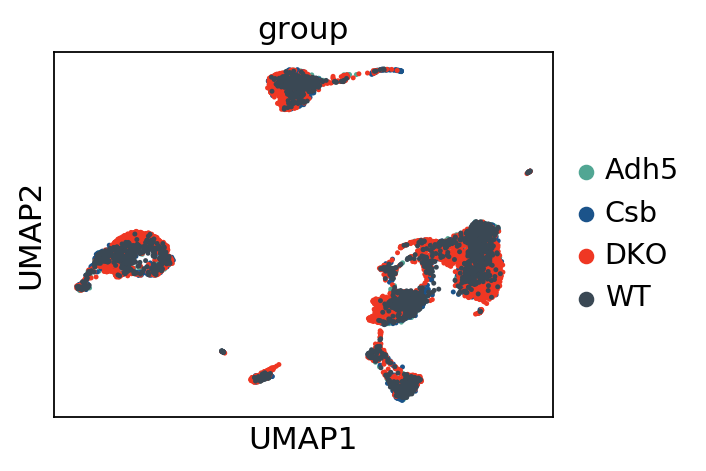

In [4]:
sc.pl.umap(imm, color = ['group'], size =20, save = '/immune_genotype_umap.df')

Trying to set attribute `.uns` of view, making a copy.


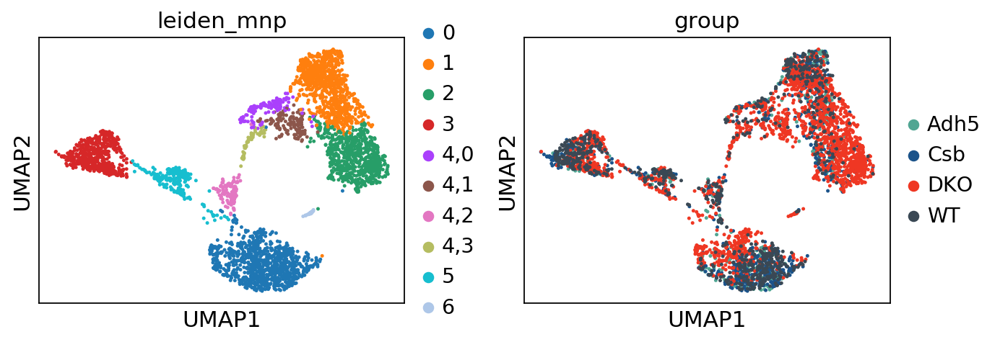

In [5]:
mnp = adata[(adata.obs['celltype'].isin(['MNP'])) & (adata.obs['percent_mito'] < 0.3)]
sc.tl.umap(mnp, min_dist =0.3)
sc.tl.leiden(mnp, key_added = 'leiden_mnp', resolution = 0.3)
sc.tl.leiden(mnp, key_added = 'leiden_mnp', resolution = 0.3, restrict_to = ('leiden_mnp', ['4']))
sc.pl.umap(mnp, color = ['leiden_mnp', 'group'], size = 20)

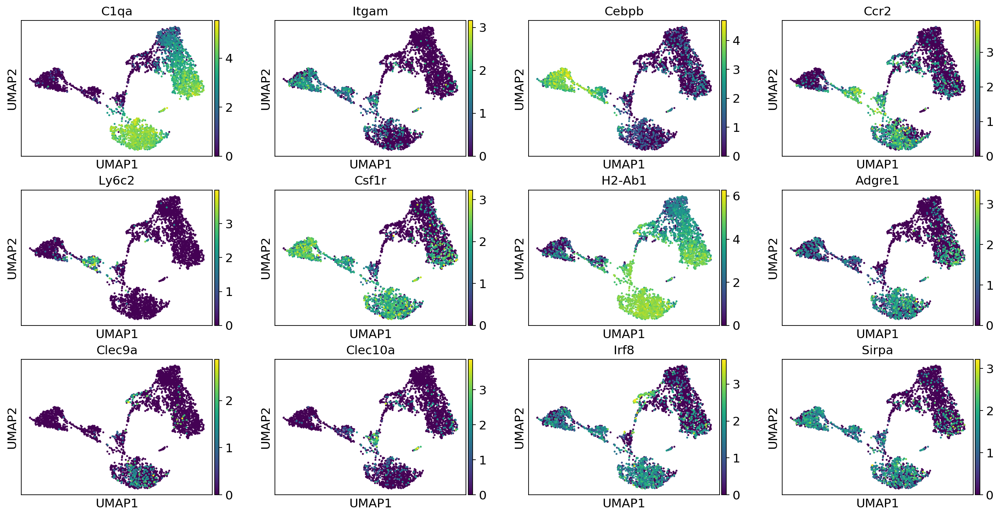

In [16]:
sc.pl.umap(mnp, color = ['C1qa', 'Itgam', 'Cebpb', 'Ccr2', 'Ly6c2', 'Csf1r', 'H2-Ab1', 'Adgre1', 'Clec9a', 'Clec10a', 'Irf8','Sirpa'], size =20)

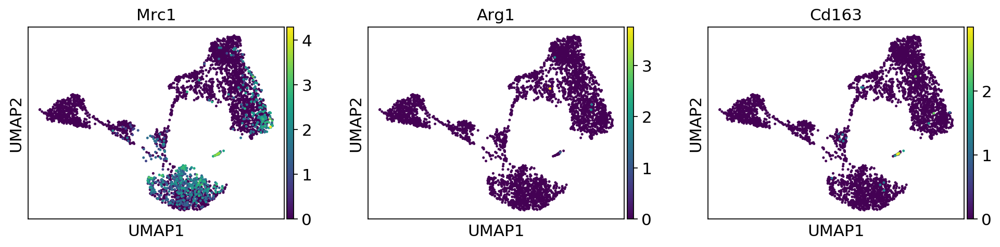

In [17]:
sc.pl.umap(mnp, color = ['Mrc1', 'Arg1', 'Cd163'], size =20)

In [ ]:
# cell = pd.crosstab(index=mnp.obs["leiden_mnp"],columns=mnp.obs["phase"]).apply(lambda r: r/r.sum(), axis=1)
# cell.plot.bar(stacked=True)

In [6]:
mnp_dict = {'0':'MHCII+ monocyte-derived Mac',
'1':'Tissue Resident Mac',
'2':'Tissue Resident Mac',
'3':'MHCII- monocyte-derived Mac',
'4,0':'cDC1',
'4,1':'Unknown monocyte/DC-like',
'4,2':'monocyte-DC_precursor',
'4,3':'CCR7+ DC',
'5':'Monocytes',
'6':'Monocyte',
'7':'M2 Tissue Resident Mac'}
mnp.obs['celltype_mnp'] = [mnp_dict[l] for l in mnp.obs['leiden_mnp']]

... storing 'celltype_mnp' as categorical


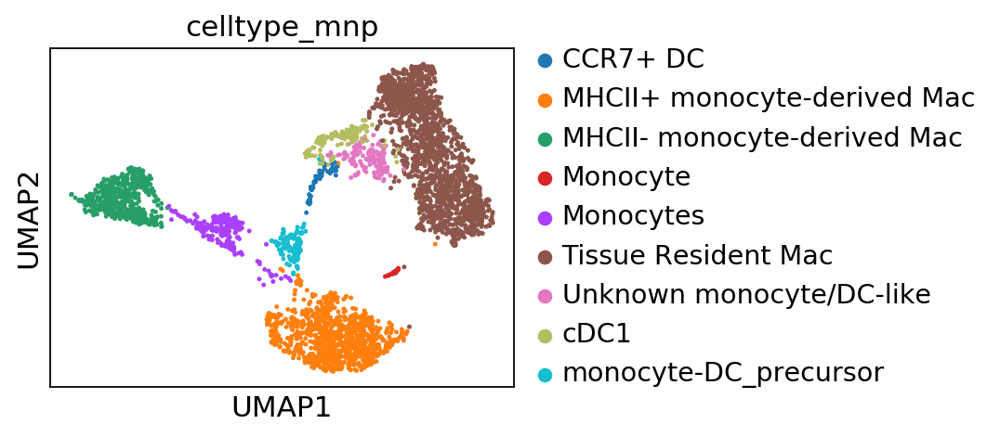

In [19]:
sc.pl.umap(mnp, color = ['celltype_mnp'], size =20, save = '/mnp_celltypes.pdf')

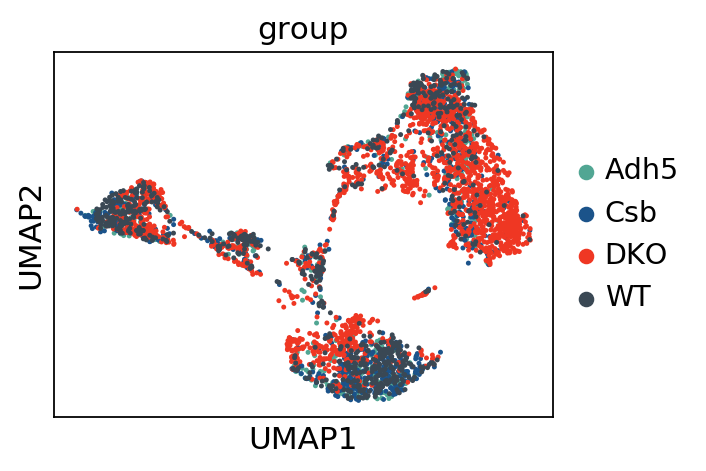

In [20]:
sc.pl.umap(mnp, color = ['group'], size =20, save = '/mnp_genotype.pdf')

In [7]:
pd.crosstab(mnp.obs['celltype_mnp'], mnp.obs['group'])

group,Adh5,Csb,DKO,WT
celltype_mnp,,,,
CCR7+ DC,1,9,47,9
MHCII+ monocyte-derived Mac,167,277,283,267
MHCII- monocyte-derived Mac,51,101,200,169
Monocyte,1,6,15,3
Monocytes,29,44,94,66
Tissue Resident Mac,168,260,926,193
Unknown monocyte/DC-like,7,11,101,13
cDC1,15,31,62,27
monocyte-DC_precursor,22,26,40,42


In [21]:
# sc.tl.rank_genes_groups(mnp, method = 'wilcoxon', groupby = 'leiden_mnp')
# sc.tl.filter_rank_genes_groups(mnp, min_fold_change=1)
# sc.pl.rank_genes_groups_dotplot(mnp, n_genes = 10, standard_scale = 'var', color_map = 'viridis', key = 'rank_genes_groups_filtered', dendrogram = False)

In [22]:
# sc.tl.rank_genes_groups(mnp, method = 'wilcoxon', groupby = 'celltype_mnp')
# sc.tl.filter_rank_genes_groups(mnp, min_fold_change=1)
# sc.pl.rank_genes_groups_dotplot(mnp, n_genes = 10, standard_scale = 'var', color_map = 'viridis', key = 'rank_genes_groups_filtered', dendrogram = False)

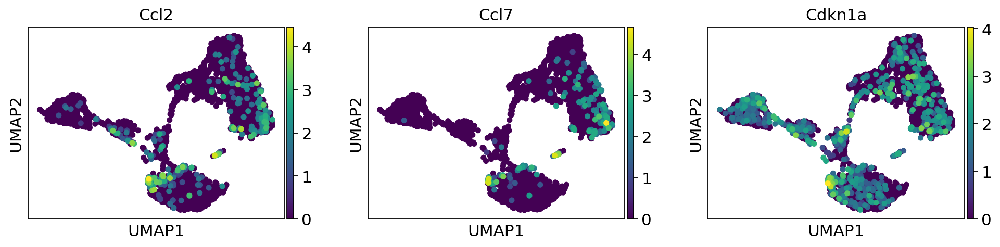

In [23]:
# import numpy as np
# import matplotlib.pyplot as plt
# from matplotlib import cm
# from matplotlib.colors import ListedColormap, LinearSegmentedColormap
# viridis = cm.get_cmap('viridis', 256)
# newcolors = viridis(np.linspace(0, 1, 256))
# grey = np.array([215/256, 215/256, 215/256, 1])
# newcolors[:1, :] = grey
# newcmp = ListedColormap(newcolors)
sc.pl.umap(mnp, color = ['Ccl2', 'Ccl7', 'Cdkn1a'], size = 100, color_map = 'viridis')

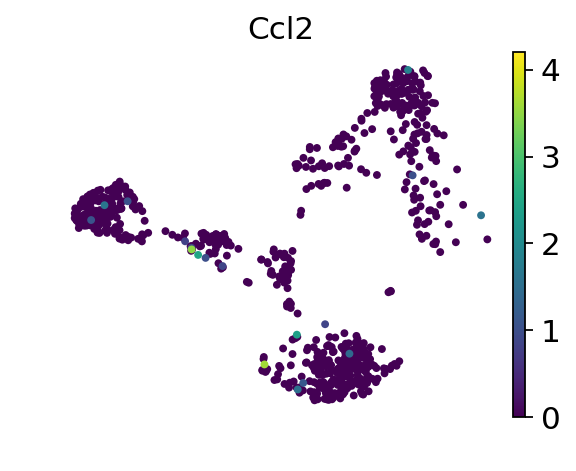

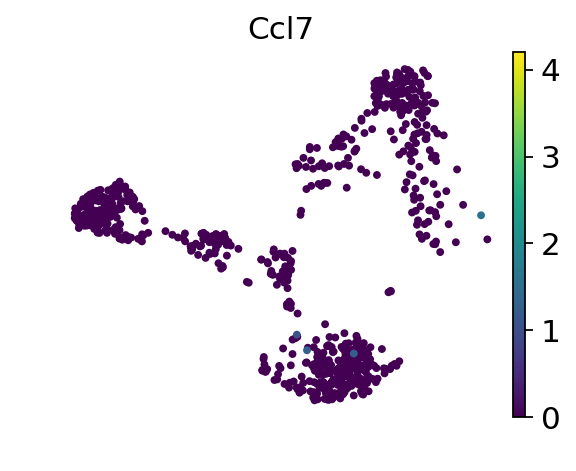

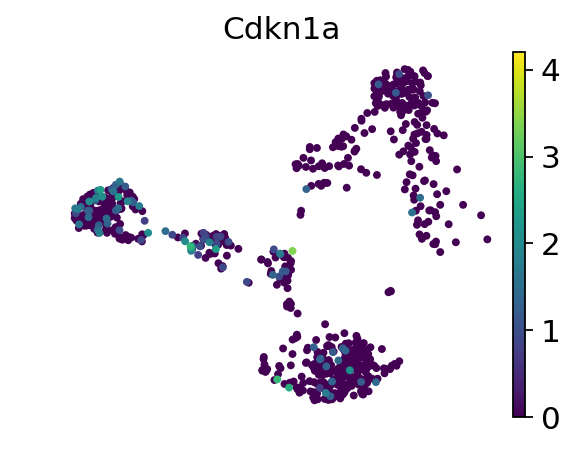

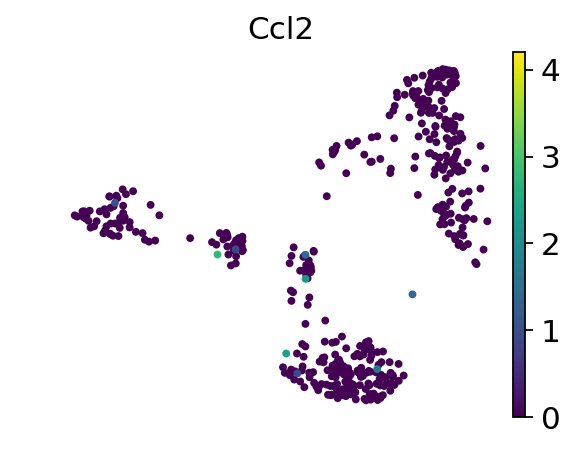

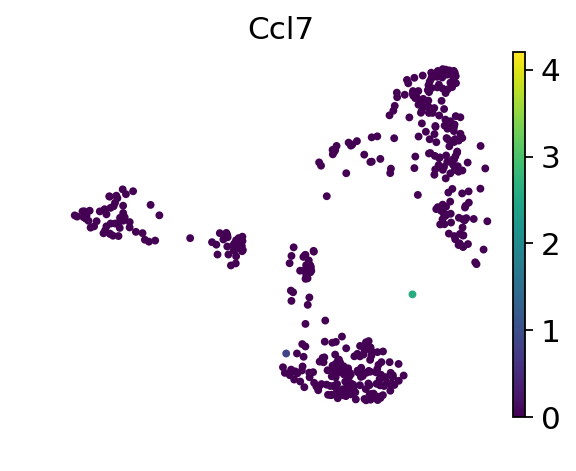

...

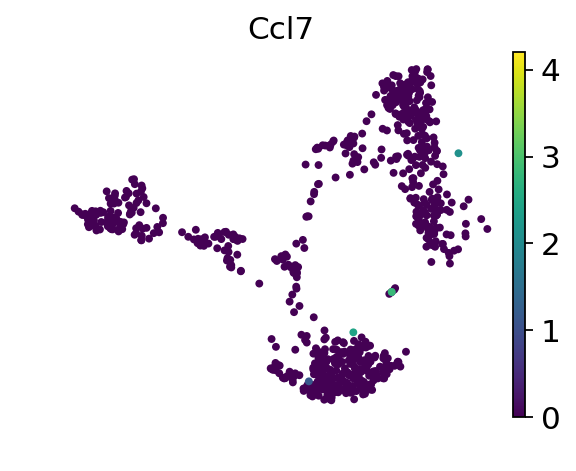

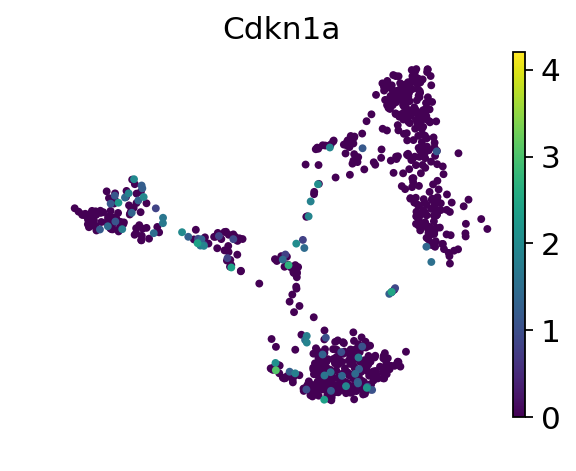

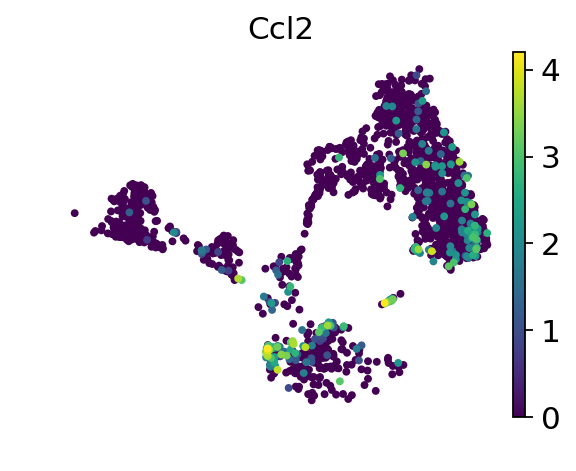

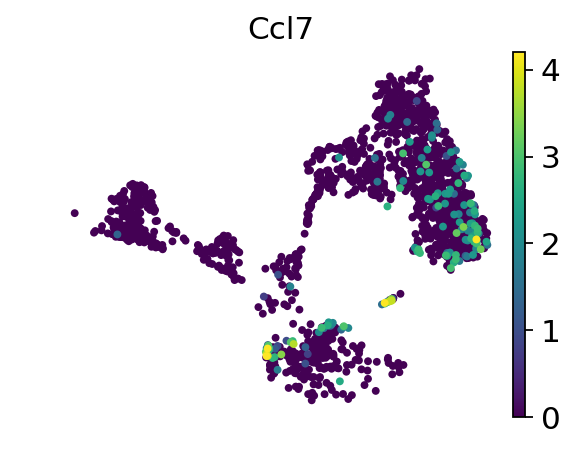

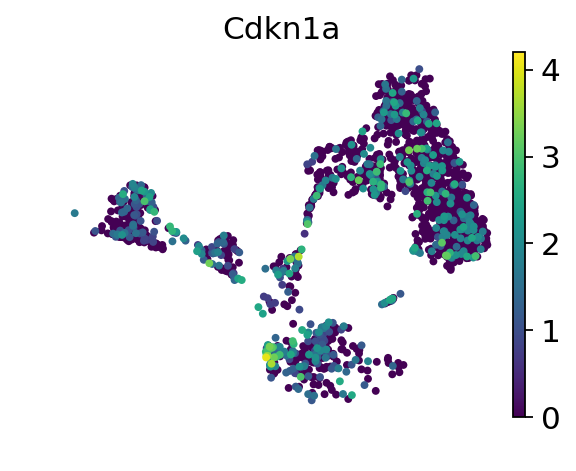

In [25]:
sc.set_figure_params(figsize = [4.0, 3.0], vector_friendly = True, dpi_save = 600)
for x in ['WT', 'Adh5', 'Csb', 'DKO']:
    # ax = sc.pl.umap(pt, show=False)
    sc.pl.umap(mnp[mnp.obs["group"] == x], color = ['Ccl2'], vmax = 4.2, color_map = 'viridis', size=50, frameon=False, save='/Lee_'+str(x)+'_Ccl2_umap.pdf')
    sc.pl.umap(mnp[mnp.obs["group"] == x], color = ['Ccl7'], vmax = 4.2, color_map = 'viridis', size=50, frameon=False, save='/Lee_'+str(x)+'_Ccl7_umap.pdf')
    sc.pl.umap(mnp[mnp.obs["group"] == x], color = ['Cdkn1a'], vmax = 4.2, color_map = 'viridis', size=50, frameon=False, save='/Lee_'+str(x)+'_Cdkn1a_umap.pdf')

In [1]:
import numpy as np
import pandas as pd
import scanpy as sc
import scrublet as scr
import os
import warnings
import functools
import seaborn as sns
import scipy.stats
import anndata
import multiprocessing

warnings.filterwarnings('ignore')
os.chdir(os.path.expanduser('/home/jovyan/Lee_KJ_Kidney_10x_sep19/scanpy'))

res_file = 'out/Lee_Sept_new.h5ad'

adata = sc.read_h5ad(res_file)

/home/jovyan/my-conda-envs/mypython3/lib/python3.7/site-packages/dask/config.py:161: YAMLLoadWarning: calling yaml.load() without Loader=... is deprecated, as the default Loader is unsafe. Please read https://msg.pyyaml.org/load for full details.
  data = yaml.load(f.read()) or {}


Trying to set attribute `.uns` of view, making a copy.


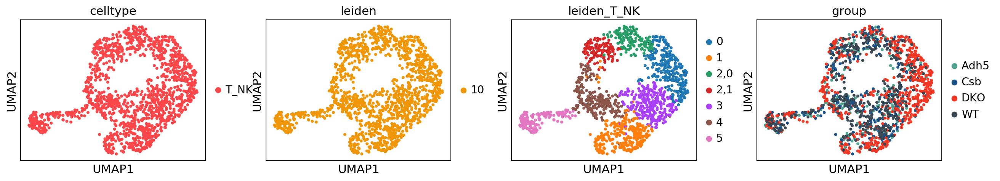

In [8]:
tnk = adata[adata.obs['celltype'].isin(['T_NK']) & (adata.obs['percent_mito'] < 0.3)]
sc.tl.umap(tnk, min_dist = 0.3)
sc.tl.leiden(tnk, key_added = 'leiden_T_NK', resolution = 0.5)
sc.tl.leiden(tnk, key_added = 'leiden_T_NK', resolution = 0.3, restrict_to= ('leiden_T_NK', ['2']))
sc.pl.umap(tnk, color = ['celltype', 'leiden', 'leiden_T_NK', 'group'], size = 50)

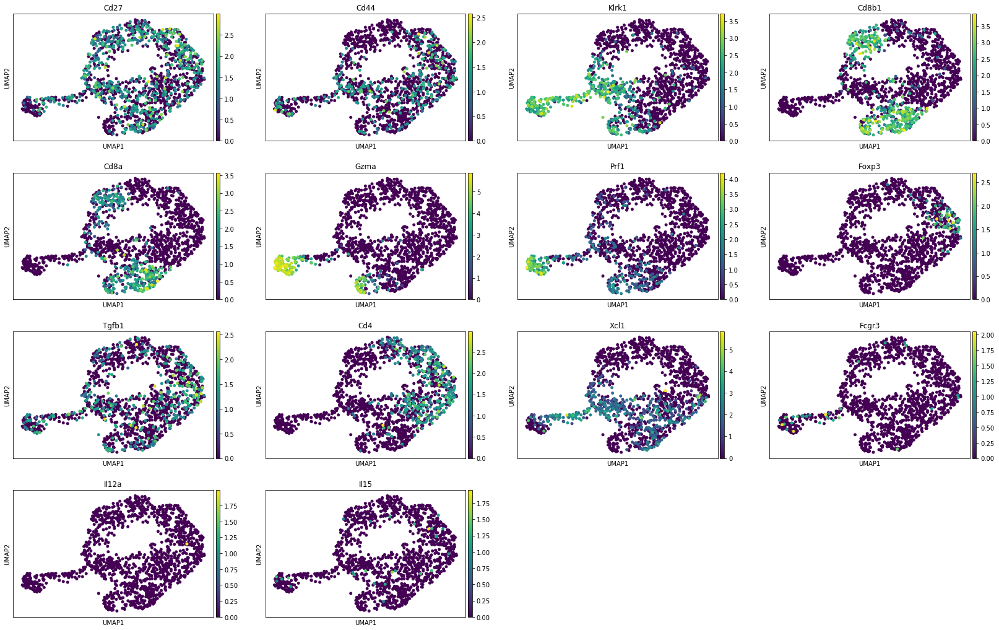

In [43]:
sc.pl.umap(tnk, color = ['Cd27', 'Cd44', 'Klrk1', 'Cd8b1', 'Cd8a', 'Gzma', 'Prf1', 'Foxp3', 'Tgfb1', 'Cd4', 'Xcl1', 'Fcgr3', 'Il12a', 'Il15'], size = 100)

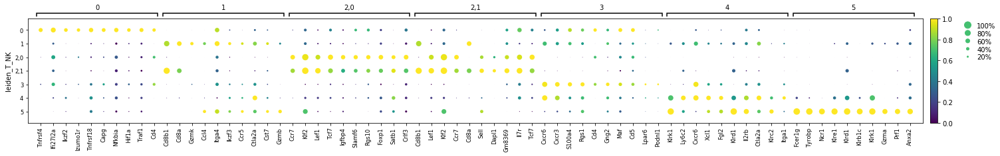

In [35]:
sc.tl.rank_genes_groups(tnk, method = 'wilcoxon', groupby = 'leiden_T_NK')
sc.tl.filter_rank_genes_groups(tnk, min_fold_change=1)
sc.pl.rank_genes_groups_dotplot(tnk, n_genes = 10, standard_scale = 'var', color_map = 'viridis', key = 'rank_genes_groups_filtered', dendrogram = False)

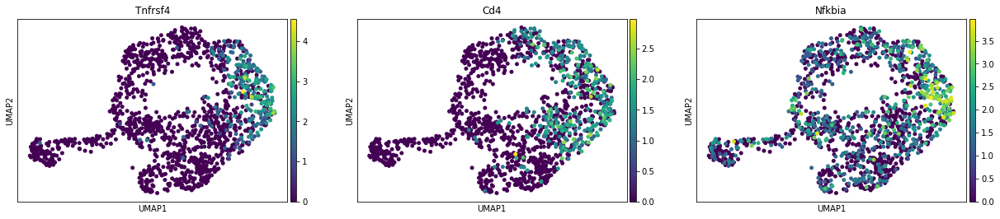

In [22]:
sc.pl.umap(tnk, color = ['Tnfrsf4', 'Cd4', 'Nfkbia'], size = 100, color_map = 'viridis')

In [9]:
tnk_dict = {'0':'Regulatory T cell',
'1':'CD8 T cell - cytotoxic',
'2,0':'CD4 T cell - naive/memory',
'2,1':'CD8 T cell - naive/memory',
'3':'CD4 T cell - effector/memory',
'4':'NK cell',
'5':'NK cell - cytotoxic'}
tnk.obs['celltype_T_NK'] = [tnk_dict[l] for l in tnk.obs['leiden_T_NK']]

... storing 'celltype_T_NK' as categorical


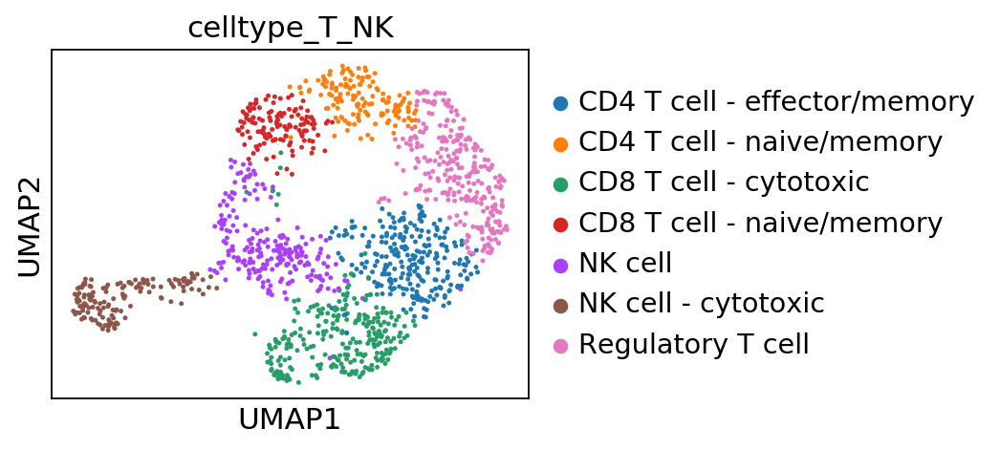

In [46]:
sc.set_figure_params(figsize = [4.0, 3.0], vector_friendly = True, dpi_save = 900)
sc.pl.umap(tnk, color = ['celltype_T_NK'], size =20, save = '/T_NK_celltypes.pdf')

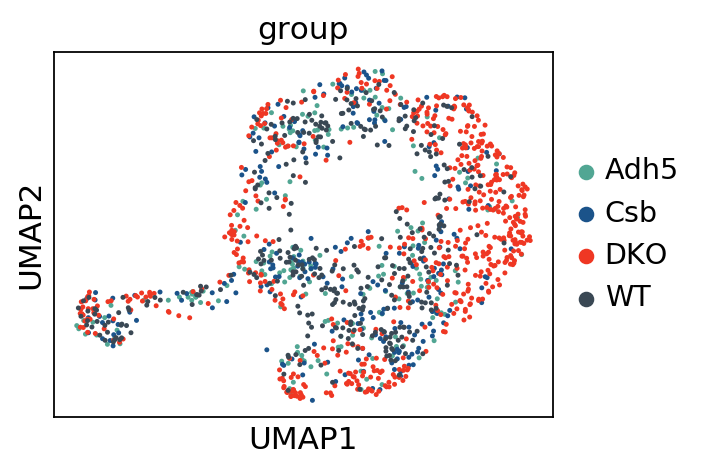

In [47]:
sc.pl.umap(tnk, color = ['group'], size =20, save = '/T_NK_genotype.pdf')

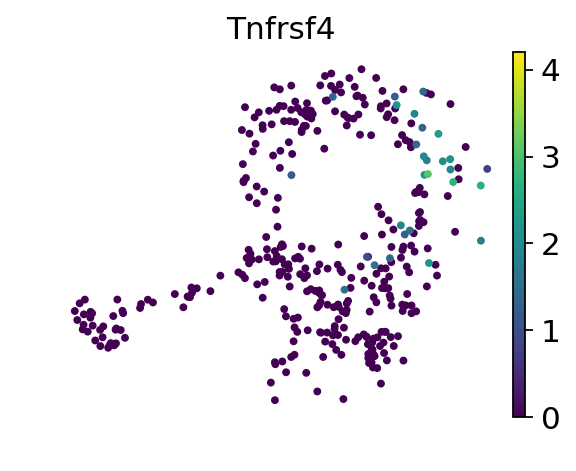

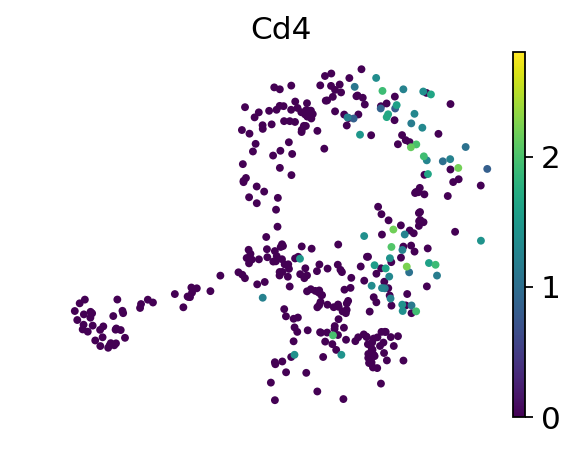

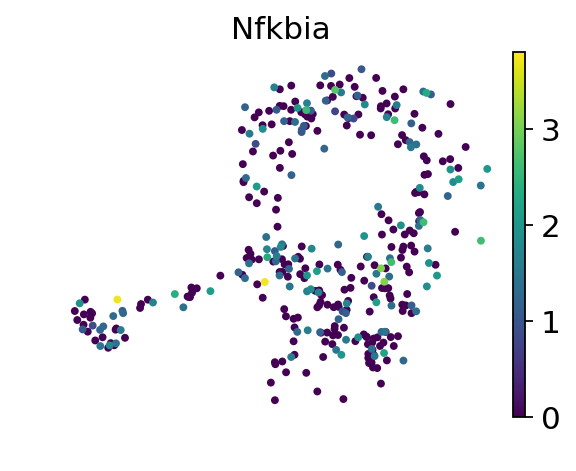

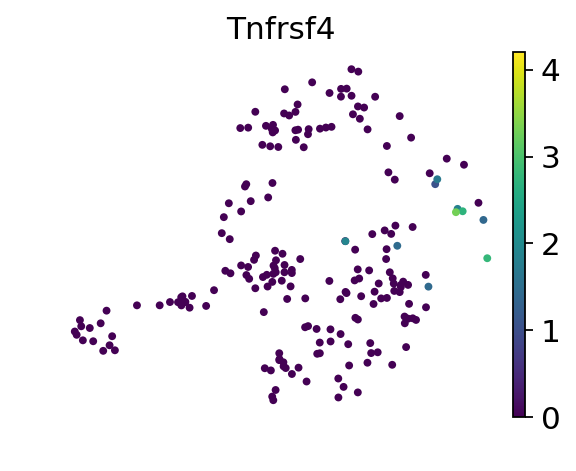

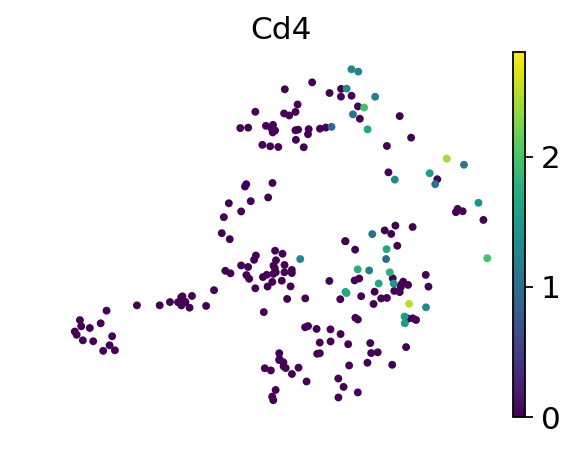

...

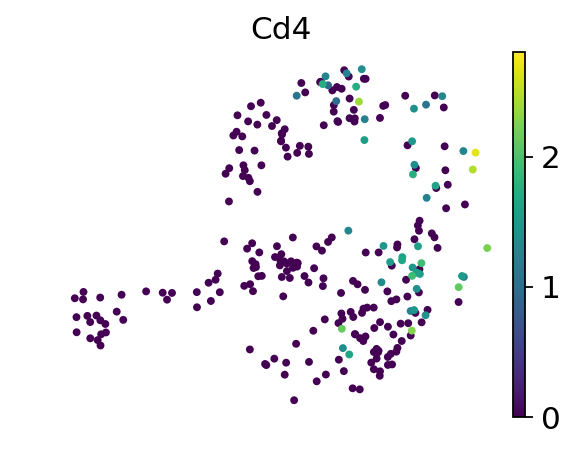

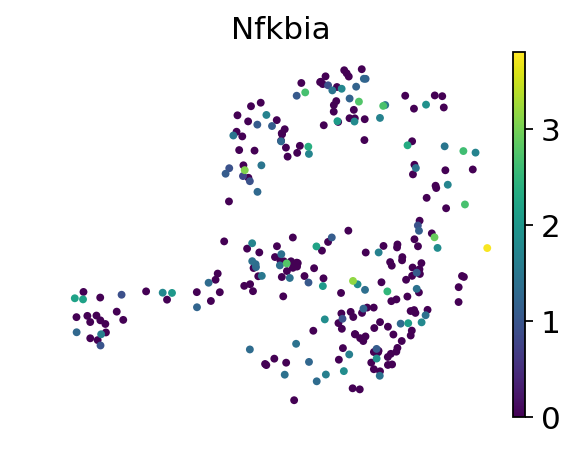

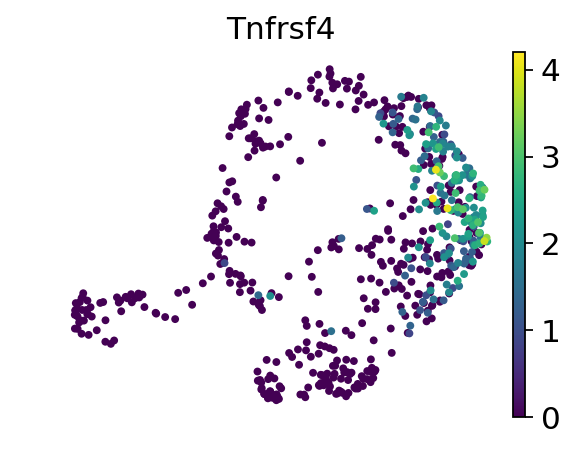

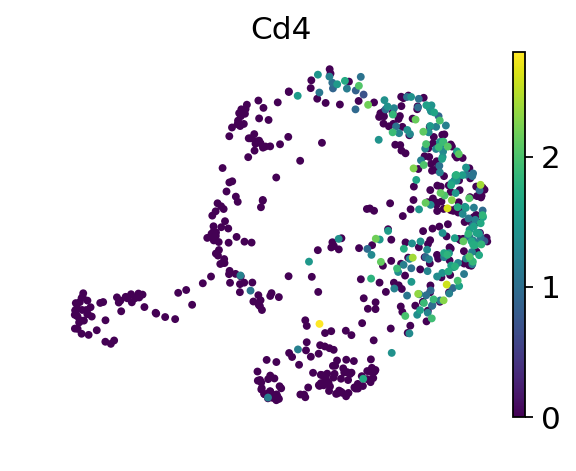

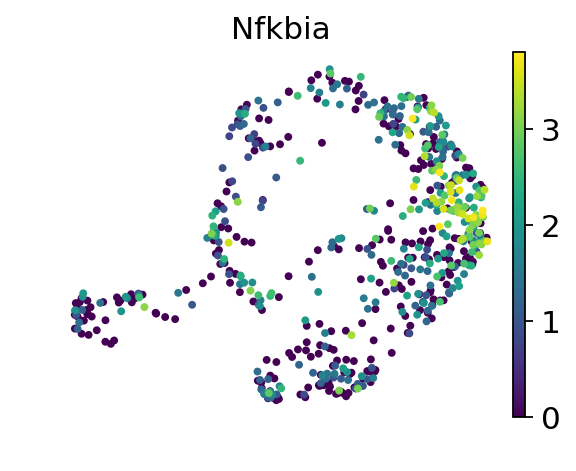

In [49]:
sc.set_figure_params(figsize = [4.0, 3.0], vector_friendly = True, dpi_save = 600)
for x in ['WT', 'Adh5', 'Csb', 'DKO']:
    # ax = sc.pl.umap(pt, show=False)
    sc.pl.umap(tnk[tnk.obs["group"] == x], color = ['Tnfrsf4'], vmax = 4.2, color_map = 'viridis', size=50, frameon=False, save='/Lee_'+str(x)+'_Tnfrsf4_umap.pdf')
    sc.pl.umap(tnk[tnk.obs["group"] == x], color = ['Cd4'], vmax = 2.8, color_map = 'viridis', size=50, frameon=False, save='/Lee_'+str(x)+'_Cd4_umap.pdf')
    sc.pl.umap(tnk[tnk.obs["group"] == x], color = ['Nfkbia'], vmax = 3.8, color_map = 'viridis', size=50, frameon=False, save='/Lee_'+str(x)+'_Nfkbia_umap.pdf')

In [10]:
pd.crosstab(tnk.obs['celltype_T_NK'], tnk.obs['group'])

group,Adh5,Csb,DKO,WT
celltype_T_NK,,,,
CD4 T cell - effector/memory,39,50,106,61
CD4 T cell - naive/memory,17,35,48,39
CD8 T cell - cytotoxic,38,53,103,76
CD8 T cell - naive/memory,24,27,33,42
NK cell,43,52,62,68
NK cell - cytotoxic,26,26,53,43
Regulatory T cell,15,22,207,36


In [1]:
import numpy as np
import pandas as pd
import scanpy as sc
import scrublet as scr
import os
import warnings
import functools
import seaborn as sns
import scipy.stats
import anndata
import multiprocessing

warnings.filterwarnings('ignore')
os.chdir(os.path.expanduser('/home/jovyan/Lee_KJ_Kidney_10x_sep19/scanpy'))

res_file = 'out/Lee_Sept_new_pt.h5ad'

adata = sc.read_h5ad(res_file)

In [2]:
sc.logging.print_versions()

scanpy==1.4.5.post2 anndata==0.6.22.post1 umap==0.4.6 numpy==1.19.2 scipy==1.5.3 pandas==0.25.3 scikit-learn==0.23.2 statsmodels==0.12.0 python-igraph==0.8.3 louvain==0.7.0


In [3]:
sc.tl.diffmap(adata)
sc.pp.neighbors(adata, n_neighbors=10, use_rep='X_diffmap')

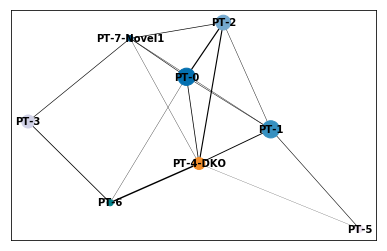

In [4]:
sc.tl.paga(adata, groups='pt_celltype')
sc.pl.paga(adata, color=['pt_celltype'])

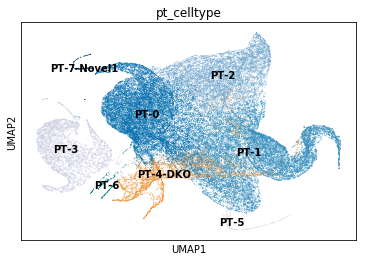

In [5]:
sc.tl.umap(adata, init_pos='paga', n_components = 2, min_dist = 0.3)
sc.pl.umap(adata, color=['pt_celltype'], legend_loc='on data')

In [6]:
adata.write('out/Lee_Sept_new_pt_paga_umap.h5ad', compression = 'gzip')

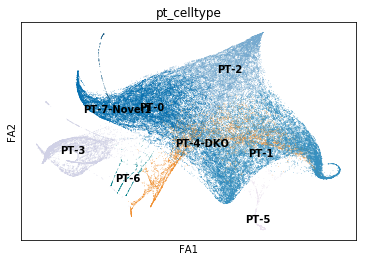

In [7]:
sc.tl.draw_graph(adata, init_pos='paga')
sc.pl.draw_graph(adata, color=['pt_celltype'], legend_loc='on data')

In [8]:
adata.write('out/Lee_Sept_new_pt_paga_umap.h5ad', compression = 'gzip')